Это ноутбук трейна модели. Описание проекта (ссылки на датасеты и авторов) можно найти на [гитхабе](https://github.com/djdjenny/medical_images_enchancement).

# Requirements

In [ ]:
SEED = 3407

In [ ]:
!pip install torchmetrics

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 963.5/963.5 kB 18.1 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 363.4/363.4 MB 3.0 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 13.8/13.8 MB 123.3 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 24.6/24.6 MB 101.4 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 883.7/883.7 kB 60.8 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 664.8/664.8 MB 1.7 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 211.5/211.5 MB 11.5 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 56.3/56.3 MB 42.0 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 127.9/127.9 MB 19.3 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 207.5/207.5 MB 3.3 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 21.1/21.1 MB 107.8 MB/s eta 0:00:00
  Attempting uninstall: nvidia-nvjitlink-cu12
    Found existing installation: nvidia-nvjitlink-cu12 12.5.82
    Unin

In [ ]:
import torch
from torchvision import transforms
import random
from torch.utils.data import Dataset
import os
import shutil
import numpy as np

import torch.nn as nn
from torch.nn import init
import functools
from torchsummary import summary

import itertools
from tqdm.auto import tqdm
from torch.utils.data import DataLoader
from torchmetrics import PeakSignalNoiseRatio
from torch.utils.tensorboard import SummaryWriter
import pickle
import matplotlib.pyplot as plt

In [ ]:
np.random.seed(SEED)

# Dataset download + preparation

## Low dose CT challenge

Скачиваем датасет, представленный на [AAPM challenge](https://www.aapm.org/grandchallenge/lowdosect/#)

### Download and unpack data

In [ ]:
!gdown --id 11NdtwNxcy24iLZLiL7lUaFH2oZ_XL3Cd -O ct_data.zip

/usr/local/lib/python3.11/dist-packages/gdown/__main__.py:140: FutureWarning: Option `--id` was deprecated in version 4.3.1 and will be removed in 5.0. You don't need to pass it anymore to use a file ID.
  warnings.warn(
Downloading...
From (original): https://drive.google.com/uc?id=11NdtwNxcy24iLZLiL7lUaFH2oZ_XL3Cd
From (redirected): https://drive.google.com/uc?id=11NdtwNxcy24iLZLiL7lUaFH2oZ_XL3Cd&confirm=t&uuid=9f90fc1f-3e28-4bfa-a117-a31c7ca1df3e
To: /content/ct_data.zip
100% 8.15G/8.15G [01:12<00:00, 112MB/s]


In [ ]:
!unzip -q /content/ct_data.zip -d /content/ct_data/

## Ultrasound dataset

Аналогичнно с датасетом соревнования [УЗИ](https://ultrasoundenhance2023.grand-challenge.org/datasets/)

In [ ]:
!gdown --id 1467p-WDOl5vpOF5wPIBxRGFjB30XgNba -O us_train_data.zip

/usr/local/lib/python3.11/dist-packages/gdown/__main__.py:140: FutureWarning: Option `--id` was deprecated in version 4.3.1 and will be removed in 5.0. You don't need to pass it anymore to use a file ID.
  warnings.warn(
Downloading...
From (original): https://drive.google.com/uc?id=1467p-WDOl5vpOF5wPIBxRGFjB30XgNba
From (redirected): https://drive.google.com/uc?id=1467p-WDOl5vpOF5wPIBxRGFjB30XgNba&confirm=t&uuid=4b9c4c0c-c7c5-4fce-ab58-c7c0a37bcb85
To: /content/us_train_data.zip
100% 70.7M/70.7M [00:00<00:00, 112MB/s]


Здесь данные разбиты на папки по органам, а затем по качеству. Возьмем 0.25 файлов из каждой папки на валидацию, сразу приведем к тензорному виду и отнормируем на диапазон 0-1.

In [ ]:
!mkdir /content/us_data/
!unzip -q /content/us_train_data.zip -d /content/us_data/

In [ ]:
!mkdir us_data/train/
!mkdir us_data/train/high_quality
!mkdir us_data/train/low_quality

In [ ]:
!mkdir us_data/test/
!mkdir us_data/test/high_quality
!mkdir us_data/test/low_quality

In [ ]:
HIGH_QUAL = 'high_quality'
LOW_QUAL = 'low_quality'

In [ ]:
from PIL import Image

In [ ]:
def move_some_files(init_dir, dest_dir_train, dest_dir_test, train_part=0.75):
    init_dir_files = os.listdir(init_dir)
    num_files_train = int(len(init_dir_files) * train_part)
    for item in init_dir_files[:num_files_train]:
        item_path = os.path.join(init_dir, item)
        if os.path.isfile(item_path):
            if os.path.exists(os.path.join(dest_dir_train, item)):
                print(f"Error while processing {item}")
            img = Image.open(item_path)
            dest_path = os.path.join(dest_dir_train, str(int(item.split('.')[0]))) + '.npy'
            np.save(dest_path, np.array(img))
    for item in init_dir_files[num_files_train:]:
        item_path = os.path.join(init_dir, item)
        if os.path.isfile(item_path):
            if os.path.exists(os.path.join(dest_dir_test, item)):
                print(f"Error while processing {item}")
            img = Image.open(item_path)
            dest_path = os.path.join(dest_dir_test, str(int(item.split('.')[0]))) + '.npy'
            np.save(dest_path, np.array(img))

In [ ]:
parent_dir = '/content/us_data/'  # Change this to your actual A directory
train_dir = os.path.join(parent_dir, 'train')
test_dir = os.path.join(parent_dir, 'test')
dataset_dir = os.path.join(parent_dir, 'train_datasets')

train_hq = os.path.join(train_dir, HIGH_QUAL, "")
train_lq = os.path.join(train_dir, LOW_QUAL, "")
test_hq = os.path.join(test_dir, HIGH_QUAL, "")
test_lq = os.path.join(test_dir, LOW_QUAL, "")
# Loop through subdirectories inside A
for subdir_name in os.listdir(dataset_dir):
    subdir_path = os.path.join(dataset_dir, subdir_name)
    hq_path = os.path.join(subdir_path, HIGH_QUAL)
    lq_path = os.path.join(subdir_path, LOW_QUAL)
    print(f'dir {subdir_path} has {len(os.listdir(hq_path))} files')
    move_some_files(hq_path, train_hq, test_hq)
    move_some_files(lq_path, train_lq, test_lq)
    shutil.rmtree(subdir_path)

dir /content/us_data/train_datasets/liver has 149 files
dir /content/us_data/train_datasets/kidney has 122 files
dir /content/us_data/train_datasets/carotid has 286 files
dir /content/us_data/train_datasets/thyroid has 291 files
dir /content/us_data/train_datasets/breast has 202 files


Проверим, что файлы правильно распределились.

In [ ]:
set(os.listdir('/content/us_data/test/high_quality')) & set(os.listdir('/content/us_data/train/high_quality'))

set()

## Dataset classes

Создадим 2 класса датасетов - makeDataset() и makeDataset_us() - во втором случае части файлов не хватает (условно, есть 40-й и 43-й файлы, но нет 41).

In [ ]:
class makeDataset(Dataset):
    def __init__(self, data_path, dataset_type, transform=None, mode='train'):
        self.transform = transform
        self.data_path = data_path
        self.mode = mode
        self.dataset_type = dataset_type
        self.random_idxs = np.arange(1, self.__len__() + 1)
        np.random.shuffle(self.random_idxs)
        self.random_idxs = list(self.random_idxs)

    def __len__(self):
        data_dir_path = os.path.join(self.data_path, self.mode, 'qd')
        return len(os.listdir(data_dir_path))

    def __getitem__(self, idx):
        root = os.path.join(self.data_path, self.mode)

        noised_path = os.path.join(root, 'qd', '{}.npy'.format(idx + 1))
        denoised_path = os.path.join(root, 'fd', '{}.npy'.format(idx + 1))
        denoised_img = torch.unsqueeze(torch.tensor(np.load(denoised_path)), dim=0)
        noised_img = torch.unsqueeze(torch.tensor(np.load(noised_path)), dim=0)
        if self.transform is not None:
            torch.manual_seed(SEED)
            denoised_img = self.transform(denoised_img)
            torch.manual_seed(SEED)
            noised_img = self.transform(noised_img)
        return denoised_img, noised_img

In [ ]:
class makeDataset_us(Dataset):
    def __init__(self, data_path, dataset_type, transform=None, mode='train'):
        self.transform = transform
        self.data_path = data_path
        self.mode = mode
        self.dataset_type = dataset_type
        self.files_list  = [f for f in os.listdir(os.path.join(self.data_path, mode, 'high_quality')) if f.endswith('.npy')]

    def __len__(self):
        data_dir_path = os.path.join(self.data_path, self.mode, 'low_quality')
        return len(os.listdir(data_dir_path))

    def __getitem__(self, idx):
        root = os.path.join(self.data_path, self.mode)
        noised_path = os.path.join(root, 'low_quality', self.files_list[idx])
        denoised_path = os.path.join(root, 'high_quality', self.files_list[idx])
        denoised_img = torch.unsqueeze(torch.tensor(np.load(denoised_path)).float()  / 255, dim=0)
        noised_img = torch.unsqueeze(torch.tensor(np.load(noised_path)).float() / 255, dim=0)
        if self.transform is not None:
            torch.manual_seed(SEED)
            denoised_img = self.transform(denoised_img)
            torch.manual_seed(SEED)
            noised_img = self.transform(noised_img)
        return denoised_img, noised_img

## US dataset difficulties

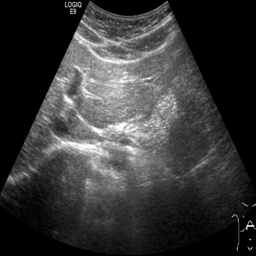
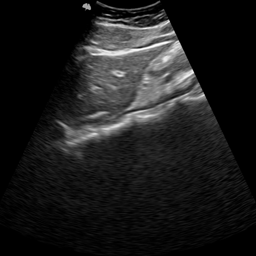

Два изображения выше считаются **соответствующими** в датасете, посвященном УЗИ. Это задача не просто увеличения качества, а скорее выделения сущностей из двух различных снимков и их сопоставление.

На некоторых (не на всех) снимках видна характерная для УЗИ картина конуса, но остальные изображения сплошные.

Размер изображений - 256х256, что в два раза меньше, чем у датасета КТ.

# Model architecture

Код генератора передан практически без изменений, дискриминатор переписан для улучшения читаемости кода.

In [ ]:
def init_weight(m, init_type='normal'):
    name = m.__class__.__name__
    if name.find('Conv') != -1:
        init.normal_(m.weight.data, 0.0, 0.02)
        if m.bias is not None:
            init.constant_(m.bias.data, 0.0)
    elif name.find('Batch') != -1:
        init.normal_(m.weight.data, 1.0, 0.02)
        init.constant_(m.bias.data, 0.0)


class UNetSkipConnectionLayer(nn.Module):
    def __init__(self, out_c, inner_c, outter=False, in_c=None, inner=False, use_drop=False,
                 norm_layer=nn.BatchNorm2d, submodule=False):
        super().__init__()
        self.outter = outter

        if in_c is None:
            in_c = out_c

        if type(norm_layer) == functools.partial:
            use_bias = (norm_layer.func == nn.InstanceNorm2d)
        else:
            use_bias = (norm_layer == nn.InstanceNorm2d)

        if self.outter:
            self.outconv = nn.Conv2d(2, out_c, kernel_size=1, stride=1)

        downrelu = nn.LeakyReLU(0.2, True)
        downConv = nn.Conv2d(in_c, inner_c, kernel_size=4, stride=2, padding=1, bias=use_bias)
        uprelu = nn.ReLU(True)
        upNorm = norm_layer(out_c)
        downNorm = norm_layer(inner_c)

        if inner:
            upConv = nn.ConvTranspose2d(inner_c, out_c, kernel_size=4, stride=2, padding=1, bias=use_bias)
            down = [downrelu, downConv]
            up = [uprelu, upConv, upNorm]
            layers = down + up
        elif outter:
            upConv = nn.ConvTranspose2d(inner_c * 2, out_c, kernel_size=4, stride=2, padding=1)
            down = [downConv]
            up = [uprelu, upConv]
            layers = down + [submodule] + up
        else:
            upConv = nn.ConvTranspose2d(inner_c * 2, out_c, kernel_size=4, stride=2, padding=1, bias=use_bias)
            down = [downrelu, downConv, downNorm]
            up = [uprelu, upConv, upNorm]
            if use_drop:
                layers = down + [submodule] + up + [nn.Dropout(0.5)]
            else:
                layers = down + [submodule] + up

        self.model = nn.Sequential(*layers)

    def forward(self, x):
        if self.outter:
            return self.outconv(torch.cat([x, self.model(x)], dim=1))
        else:
            return torch.cat([x, self.model(x)], dim=1)


class UNetGenerator(nn.Module):
    def __init__(self, in_c, out_c, num_downs=8, ngf=64, norm_layer=nn.BatchNorm2d, use_drop=False):
        super().__init__()
        block = UNetSkipConnectionLayer(8 * ngf, 8 * ngf, inner=True, norm_layer=norm_layer)
        for i in range(num_downs - 5):
            block = UNetSkipConnectionLayer(8 * ngf, 8 * ngf, norm_layer=norm_layer, use_drop=use_drop, submodule=block)
        block = UNetSkipConnectionLayer(4 * ngf, 8 * ngf, norm_layer=norm_layer, submodule=block)
        block = UNetSkipConnectionLayer(2 * ngf, 4 * ngf, norm_layer=norm_layer, submodule=block)
        block = UNetSkipConnectionLayer(ngf, 2 * ngf, norm_layer=norm_layer, submodule=block)
        self.model = UNetSkipConnectionLayer(out_c, ngf, in_c=in_c, norm_layer=norm_layer, submodule=block, outter=True)

    def forward(self, x):
        return self.model(x)

In [ ]:
class DiscriminatorBlock(nn.Module):
    def __init__(self, in_c, out_c,  kernel_size=4, stride=2, padding=1, bias=False, norm_layer=nn.BatchNorm2d):
        super().__init__()
        self.conv = nn.Conv2d(in_c, out_c, kernel_size=4, stride=2, padding=1, bias=bias)
        self.batchnorm = norm_layer(out_c)
        self.relu = nn.LeakyReLU(0.2, True)


    def forward(self, x):
        return self.relu(self.batchnorm(self.conv(x)))

In [ ]:
class Discriminator(nn.Module):
    def __init__(self, in_c, ndf=64, n_layers=3, norm_layer=nn.BatchNorm2d):
        super().__init__()
        if type(norm_layer) == functools.partial:
            use_bias = norm_layer.func == nn.InstanceNorm2d
        else:
            use_bias = norm_layer == nn.InstanceNorm2d
        self.layers = nn.ModuleList([
            nn.Conv2d(in_c, ndf, kernel_size=4, stride=2, padding=1),
            nn.LeakyReLU(0.2, inplace=True)]
        )
        for i in range(1, n_layers):
            self.layers.append(DiscriminatorBlock(in_c=i*ndf, out_c=2*i*ndf, bias=use_bias))
        n_cur = min(2 ** n_layers, 8)
        self.layers.append(DiscriminatorBlock(in_c=2*(n_layers-1)*ndf, out_c=4*(n_layers-1)*ndf, stride=1, bias=use_bias))
        self.layers.append(nn.Conv2d(4*(n_layers-1)*ndf, 1, kernel_size=4, stride=1, padding=1))

    def forward(self, x):
        for layer in self.layers:
            x = layer(x)
        return x

In [ ]:
class Buffer:
    def __init__(self, buffer_size=50):
        self.buffer = []
        self.buffer_size = buffer_size
        self.cur_size = 0

    def push_pop(self, image):
        return_img = []
        for img in image.data:
            img = torch.unsqueeze(img, 0)
            if self.cur_size < self.buffer_size:
                self.cur_size += 1
                return_img.append(img)
                self.buffer.append(img)
            else:
                p = random.uniform(0, 1)
                if p > 0.5:
                    idx = random.randint(0, self.buffer_size - 1)
                    old_img = self.buffer[idx].clone()
                    return_img.append(old_img)
                    self.buffer[idx] = img
                else:
                    return_img.append(img)
        return torch.cat(return_img, dim=0)


class LambdaLR():
    def __init__(self, n_epochs, decay_start_epoch=None, offset=0):

        self.n_epochs = n_epochs
        self.offset = offset
        if decay_start_epoch is None:
            self.decay_start_epoch = int(n_epochs / 2)
        else:
            self.decay_start_epoch = decay_start_epoch

    def step(self, epoch):
        return 1.0 - max(0, epoch + self.offset - self.decay_start_epoch) / (self.n_epochs - self.decay_start_epoch)

In [ ]:
def normalize(tensor,zero2one=False):
    shape=tensor.shape
    tensor_norm=tensor.reshape([shape[0],shape[1],-1])
    tensor_max=tensor_norm.max(dim=-1,keepdim=True)[0]
    tensor_min=tensor_norm.min(dim=-1,keepdim=True)[0]
    tensor_norm=((tensor_norm-tensor_min)/(tensor_max-tensor_min))
    if zero2one:
        tensor_norm=tensor_norm.reshape(shape)
    else:
        tensor_norm=((tensor_norm-0.5)*2.0).reshape(shape)
    return tensor_norm

# Train

Трейн обернут в функцию и отрефакторен - добавлены in-progress сообщения и картинки, но убран SummaryWriter.

In [ ]:
def train_model(D_A, D_B, G_A2B, G_B2A, train_loader, valid_loader, batch_size, epochs, result_dir, history, lambda_identity = 0.5):
    trainstep=(len(train_loader.dataset)//batch_size)+1
    outtertqdm=tqdm(range(epochs))
    best_psnr=0
    optGAN=torch.optim.Adam(itertools.chain(G_A2B.parameters(),G_B2A.parameters()),lr=lr,betas=(0.5,0.999))
    optD=torch.optim.Adam(itertools.chain(D_A.parameters(),D_B.parameters()),lr=lr,betas=(0.5,0.999))
    BufferA=Buffer()
    BufferB=Buffer()

    lr_schedular_G=torch.optim.lr_scheduler.LambdaLR(optGAN,lr_lambda=LambdaLR(epochs).step)
    lr_schedular_D=torch.optim.lr_scheduler.LambdaLR(optD,lr_lambda=LambdaLR(epochs).step)
    for epoch in outtertqdm:
        innertqdm=tqdm(range(trainstep),leave=False)
        dataiter=iter(train_loader)
        G_A2B.train()
        G_B2A.train()
        D_A.train()
        D_B.train()

        stepcnt=0
        stepValidcnt=0
        total_loss_g = {'A': 0, 'cycle_A': 0, 'idt_A': 0,
                        'B': 0, 'cycle_B': 0, 'idt_B': 0}
        total_loss_d = {'A': 0, 'B': 0}
        totalPSNR=0

        for step in innertqdm:
            stepcnt+=1
            (realA,realB)=next(dataiter)
            (realA,realB)=(realA.to(DEVICE),realB.to(DEVICE))
            ######################################Generator#############################################
            optGAN.zero_grad()
            #####Identity Loss#####
            loss_idt_A=lossIdentity(G_B2A(realA),realA)*lambda_A*lambda_identity
            loss_idt_B=lossIdentity(G_A2B(realB),realB)*lambda_B*lambda_identity
            #####GAN Loss#####
            fakeA=G_B2A(realB)
            fakeB=G_A2B(realA)
            #print(fakeA.shape)
            #print(D_A)
            pred_D_A_fakeA=D_A(fakeA)
            pred_D_B_fakeB=D_B(fakeB)

            targetReal=torch.ones_like(pred_D_A_fakeA,device=DEVICE)
            targetFake=torch.zeros_like(pred_D_A_fakeA,device=DEVICE)

            loss_G_A2B=lossGAN(pred_D_B_fakeB,targetReal)
            loss_G_B2A=lossGAN(pred_D_A_fakeA,targetReal)
            #####Cycle Loss#####

            cycleA=G_B2A(fakeB)
            cycleB=G_A2B(fakeA)

            loss_cycle_A=lossCycle(cycleA,realA)*lambda_A
            loss_cycle_B=lossCycle(cycleB,realB)*lambda_B
            #####Final Loss#####
            lossG=loss_G_A2B+loss_G_B2A+loss_cycle_A+loss_cycle_B+loss_idt_A+loss_idt_B
            lossG.backward()
            optGAN.step()
            total_loss_g['A'] += loss_G_A2B
            total_loss_g['cycle_A'] += loss_cycle_A
            total_loss_g['idt_A'] =+ loss_idt_A
            total_loss_g['B'] += loss_G_B2A
            total_loss_g['cycle_B'] += loss_cycle_B
            total_loss_g['idt_B'] =+ loss_idt_B
            ###################################Discriminator##########################################
            optD.zero_grad()
            #####Discriminator A Loss#####
            fakeA=BufferA.push_pop(fakeA)
            loss_D_A_Real=lossGAN(D_A(realA),targetReal)
            loss_D_A_Fake=lossGAN(D_A(fakeA.detach()),targetFake)
            loss_D_A=(loss_D_A_Fake+loss_D_A_Real)*0.5
            #####Discriminator B Loss#####
            fakeB=BufferB.push_pop(fakeB)
            loss_D_B_Real=lossGAN(D_B(realB),targetReal)
            loss_D_B_Fake=lossGAN(D_B(fakeB.detach()),targetFake)
            loss_D_B=(loss_D_B_Real+loss_D_B_Fake)*0.5
            #####Final Loss#####
            loss_D_A.backward()
            loss_D_B.backward()
            optD.step()

            total_loss_d['A'] += loss_D_A
            total_loss_d['B'] += loss_D_B
        if epoch % 5 == 0:
            fig, axs = plt.subplots(2, 2)
            fig.suptitle(f'Images on epoch {epoch}')
            axs[0, 0].imshow(realA[0][0].cpu().detach())
            axs[0, 0].set_title('real good quality')
            axs[0, 1].imshow(realB[0][0].cpu().detach())
            axs[0, 1].set_title('real bad quality')
            axs[1, 0].imshow(fakeA[0][0].cpu().detach())
            axs[1, 0].set_title('fake good quality (BQ -> GQ)')
            axs[1, 1].imshow(fakeB[0][0].cpu().detach())
            axs[1, 1].set_title('fake bad quality (GQ -> BQ)')
            plt.tight_layout()
            plt.show()

        with torch.no_grad():
            G_B2A.eval() #B: qd   A: fd
            for (realA,realB) in valid_loader:
                (realA,realB)=(realA.to(DEVICE),realB.to(DEVICE))
                fakeA=G_B2A(realB)

                fakeA=normalize(fakeA,zero2one=True)
                realA=normalize(realA,zero2one=True)
                batch_psnr=psnr(fakeA,realA)
                totalPSNR+=batch_psnr
                stepValidcnt+=1

        avgLoss_G_A=total_loss_g['A'].cpu().detach().numpy()/stepcnt
        avgLoss_G_Cycle_A=total_loss_g['cycle_A'].cpu().detach().numpy()/stepcnt
        avgLoss_G_idt_A=total_loss_g['idt_A'].cpu().detach().numpy()/stepcnt

        avgLoss_G_B=total_loss_g['B'].cpu().detach().numpy()/stepcnt
        avgLoss_G_Cycle_B=total_loss_g['cycle_B'].cpu().detach().numpy()/stepcnt
        avgLoss_G_idt_B=total_loss_g['idt_B'].cpu().detach().numpy()/stepcnt

        avgLoss_D_A=total_loss_d['A'].cpu().detach().numpy()/stepcnt
        avgLoss_D_B=total_loss_d['B'].cpu().detach().numpy()/stepcnt
        avgPSNR=totalPSNR.cpu().detach().numpy()/stepValidcnt

        history['loss_G_A'].append(avgLoss_G_A)
        history['loss_Cycle_A'].append(avgLoss_G_Cycle_A)
        history['loss_idt_A'].append(avgLoss_G_idt_A)
        history['loss_G_B'].append(avgLoss_G_B)
        history['loss_Cycle_B'].append(avgLoss_G_Cycle_B)
        history['loss_idt_B'].append(avgLoss_G_idt_B)
        history['loss_D_A'].append(avgLoss_D_A)
        history['loss_D_B'].append(avgLoss_D_B)
        history['PSNR'].append(avgPSNR)

        lr_schedular_G.step()
        lr_schedular_D.step()
        print(f"average PSNR for epoch {epoch} is {avgPSNR}")
        outtertqdm.set_postfix({'PSNR':'{:.03f}'.format(avgPSNR),'Diff':'{:.03f}'.format(avgPSNR-26.9565)})

        if best_psnr<avgPSNR:
            best_psnr=avgPSNR
            torch.save(G_A2B,f'{result_dir}/GAN_FD_to_QD/GAN.pt')
            torch.save(G_B2A,f'{result_dir}/GAN_QD_to_FD/GAN.pt')
            torch.save(D_A,f'{result_dir}/Discriminator_A/Disc_A.pt')
            torch.save(D_B,f'{result_dir}/Discriminator_B/Disc_B.pt')

            with open(f'{result_dir}/history.pkl','wb') as f:
                pickle.dump(history,f)

    return history, D_A, D_B, G_A2B, G_B2A

## CT train

In [ ]:
norm_type='batch'
epochs=100
lambda_A=10.0
lambda_B=10.0
lr=0.0002
ngf=64
ndf=64
use_droplayer=False
batch_size=32
norm_layer = functools.partial(nn.InstanceNorm2d, affine=False, track_running_stats=False)
DEVICE='cuda' if torch.cuda.is_available() else 'cpu'

In [ ]:
G_A2B_ct=UNetGenerator(in_c=1,out_c=1,ngf=ngf,norm_layer=norm_layer,use_drop=use_droplayer)
G_B2A_ct=UNetGenerator(in_c=1,out_c=1,ngf=ngf,norm_layer=norm_layer,use_drop=use_droplayer)

D_A_ct=Discriminator(in_c=1,ndf=ndf,n_layers=3,norm_layer=norm_layer)
D_B_ct=Discriminator(in_c=1,ndf=ndf,n_layers=3,norm_layer=norm_layer)

In [ ]:
G_A2B_ct.to(DEVICE)
G_B2A_ct.to(DEVICE)
D_A_ct.to(DEVICE)
D_B_ct.to(DEVICE)

G_A2B_ct.apply(init_weight)
G_B2A_ct.apply(init_weight)
D_A_ct.apply(init_weight)
D_B_ct.apply(init_weight)

if torch.cuda.device_count() > 1:
    print('training with {} GPUs'.format(torch.cuda.device_count()))
    G_A2B=torch.nn.DataParallel(G_A2B_ct)
    G_B2A=torch.nn.DataParallel(G_B2A_ct)
    D_A=torch.nn.DataParallel(D_A_ct)
    D_B=torch.nn.DataParallel(D_B_ct)

In [ ]:
lossGAN=nn.MSELoss()
lossCycle=nn.L1Loss()
lossIdentity=nn.L1Loss()

In [ ]:
psnr=PeakSignalNoiseRatio(data_range=1,dim=[-1,-2,-3])

trainTransforms=transforms.Compose([
    transforms.RandomCrop((256,256)),
])

ct_trainDataset=makeDataset('/content/ct_data/data', 'ct', trainTransforms)
ct_validDataset=makeDataset('/content/ct_data/data', 'ct', transform=None, mode='test')

ct_trainLoader=DataLoader(ct_trainDataset,batch_size=batch_size,shuffle=True)
ct_validLoader=DataLoader(ct_validDataset,batch_size=batch_size,shuffle=False)



history_ct={'loss_G_A':[],'loss_Cycle_A':[],'loss_idt_A':[],
         'loss_G_B':[],'loss_Cycle_B':[],'loss_idt_B':[],'loss_D_A':[],'loss_D_B':[],'PSNR':[]}

if not os.path.exists('./ct_final_result'):
    os.makedirs('./ct_final_result')
if not os.path.exists('./ct_final_result/GAN_FD_to_QD'):
    os.makedirs('./ct_final_result/GAN_FD_to_QD')
if not os.path.exists('./ct_final_result/GAN_QD_to_FD'):
    os.makedirs('./ct_final_result/GAN_QD_to_FD')
if not os.path.exists('./ct_final_result/Discriminator_A'):
    os.makedirs('./ct_final_result/Discriminator_A')
if not os.path.exists('./ct_final_result/Discriminator_B'):
    os.makedirs('./ct_final_result/Discriminator_B')


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/120 [00:00<?, ?it/s]

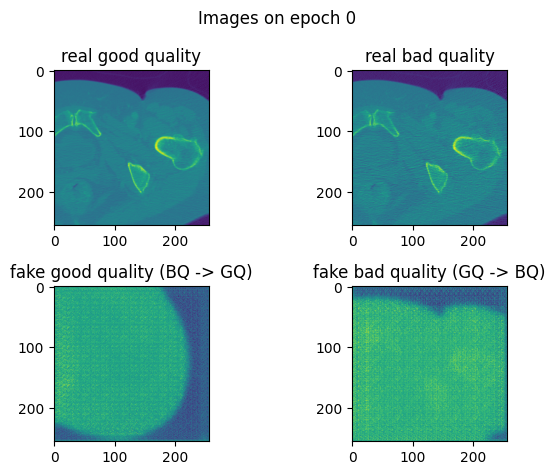

average PSNR for epoch 0 is 13.867419242858887


  0%|          | 0/120 [00:00<?, ?it/s]

average PSNR for epoch 1 is 15.322693824768066


  0%|          | 0/120 [00:00<?, ?it/s]

average PSNR for epoch 2 is 15.610322952270508


  0%|          | 0/120 [00:00<?, ?it/s]

average PSNR for epoch 3 is 17.53017234802246


  0%|          | 0/120 [00:00<?, ?it/s]

average PSNR for epoch 4 is 16.838985443115234


  0%|          | 0/120 [00:00<?, ?it/s]

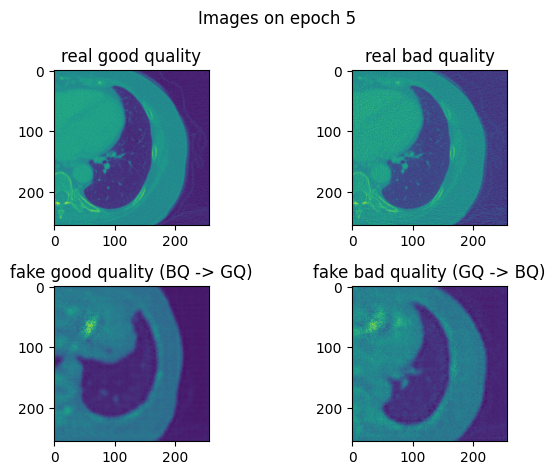

average PSNR for epoch 5 is 18.218868255615234


  0%|          | 0/120 [00:00<?, ?it/s]

average PSNR for epoch 6 is 20.734296798706055


  0%|          | 0/120 [00:00<?, ?it/s]

average PSNR for epoch 7 is 21.941259384155273


  0%|          | 0/120 [00:00<?, ?it/s]

average PSNR for epoch 8 is 21.8096981048584


  0%|          | 0/120 [00:00<?, ?it/s]

average PSNR for epoch 9 is 22.033769607543945


  0%|          | 0/120 [00:00<?, ?it/s]

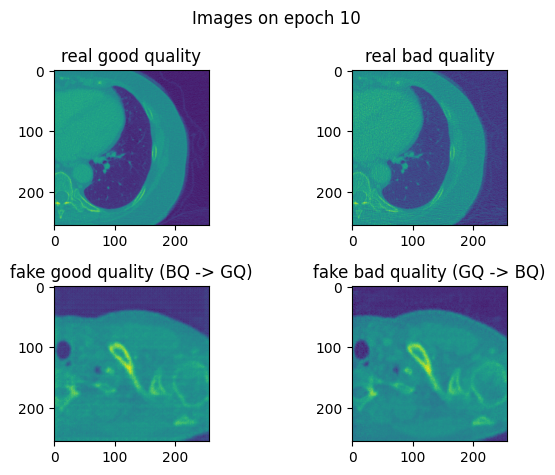

average PSNR for epoch 10 is 21.42783546447754


  0%|          | 0/120 [00:00<?, ?it/s]

average PSNR for epoch 11 is 22.42424964904785


  0%|          | 0/120 [00:00<?, ?it/s]

average PSNR for epoch 12 is 24.485828399658203


  0%|          | 0/120 [00:00<?, ?it/s]

average PSNR for epoch 13 is 24.91288948059082


  0%|          | 0/120 [00:00<?, ?it/s]

average PSNR for epoch 14 is 25.083864212036133


  0%|          | 0/120 [00:00<?, ?it/s]

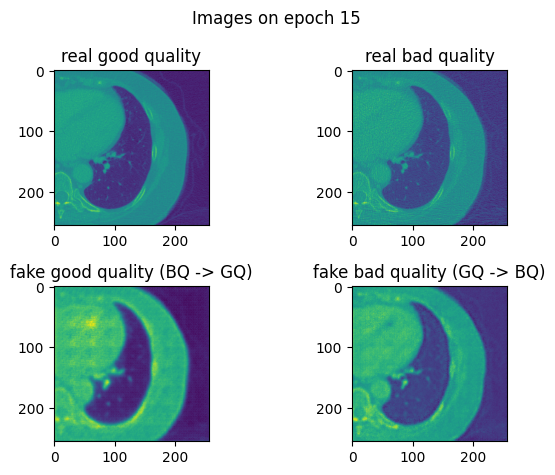

average PSNR for epoch 15 is 20.802684783935547


  0%|          | 0/120 [00:00<?, ?it/s]

average PSNR for epoch 16 is 23.049121856689453


  0%|          | 0/120 [00:00<?, ?it/s]

average PSNR for epoch 17 is 25.295654296875


  0%|          | 0/120 [00:00<?, ?it/s]

average PSNR for epoch 18 is 25.224340438842773


  0%|          | 0/120 [00:00<?, ?it/s]

average PSNR for epoch 19 is 23.85599708557129


  0%|          | 0/120 [00:00<?, ?it/s]

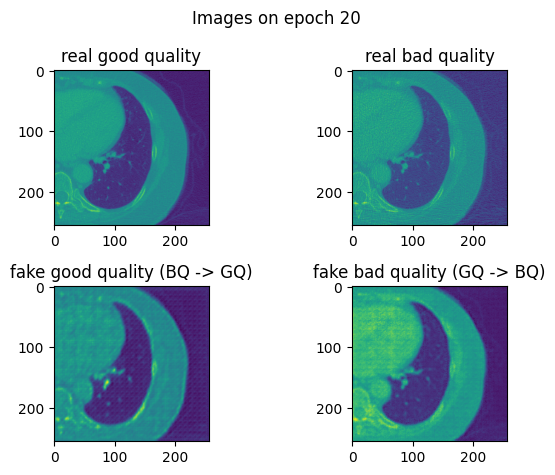

average PSNR for epoch 20 is 24.806116104125977


  0%|          | 0/120 [00:00<?, ?it/s]

average PSNR for epoch 21 is 25.041200637817383


  0%|          | 0/120 [00:00<?, ?it/s]

average PSNR for epoch 22 is 24.16180419921875


  0%|          | 0/120 [00:00<?, ?it/s]

average PSNR for epoch 23 is 26.1741943359375


  0%|          | 0/120 [00:00<?, ?it/s]

average PSNR for epoch 24 is 26.038127899169922


  0%|          | 0/120 [00:00<?, ?it/s]

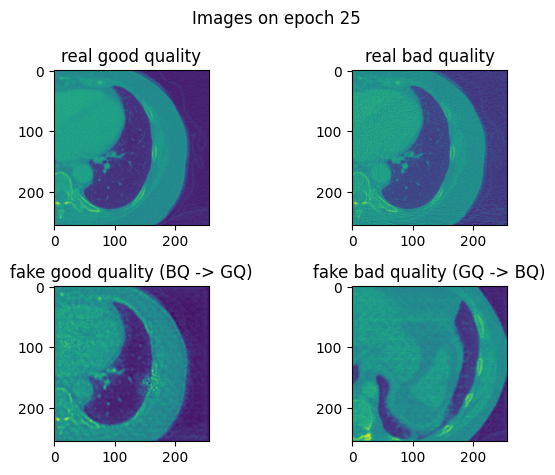

average PSNR for epoch 25 is 26.4139347076416


  0%|          | 0/120 [00:00<?, ?it/s]

average PSNR for epoch 26 is 23.940937042236328


  0%|          | 0/120 [00:00<?, ?it/s]

average PSNR for epoch 27 is 20.787195205688477


  0%|          | 0/120 [00:00<?, ?it/s]

average PSNR for epoch 28 is 26.530607223510742


  0%|          | 0/120 [00:00<?, ?it/s]

average PSNR for epoch 29 is 26.211727142333984


  0%|          | 0/120 [00:00<?, ?it/s]

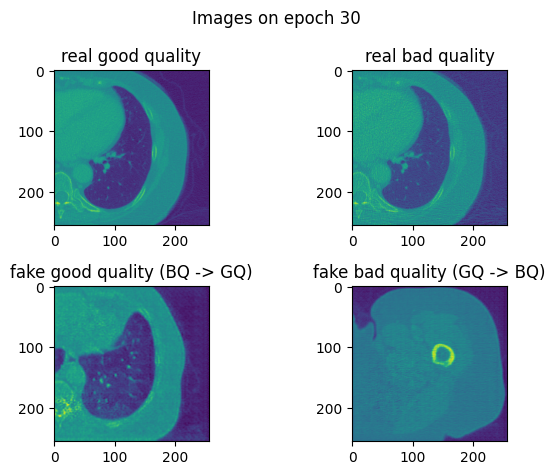

average PSNR for epoch 30 is 24.421825408935547


  0%|          | 0/120 [00:00<?, ?it/s]

average PSNR for epoch 31 is 25.55367660522461


  0%|          | 0/120 [00:00<?, ?it/s]

average PSNR for epoch 32 is 19.369009017944336


  0%|          | 0/120 [00:00<?, ?it/s]

average PSNR for epoch 33 is 25.363237380981445


  0%|          | 0/120 [00:00<?, ?it/s]

average PSNR for epoch 34 is 22.763336181640625


  0%|          | 0/120 [00:00<?, ?it/s]

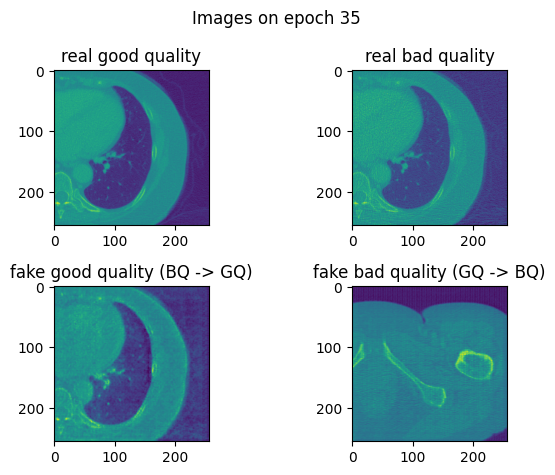

average PSNR for epoch 35 is 22.224863052368164


  0%|          | 0/120 [00:00<?, ?it/s]

average PSNR for epoch 36 is 24.1123104095459


  0%|          | 0/120 [00:00<?, ?it/s]

average PSNR for epoch 37 is 22.858556747436523


  0%|          | 0/120 [00:00<?, ?it/s]

average PSNR for epoch 38 is 25.994892120361328


  0%|          | 0/120 [00:00<?, ?it/s]

average PSNR for epoch 39 is 24.654163360595703


  0%|          | 0/120 [00:00<?, ?it/s]

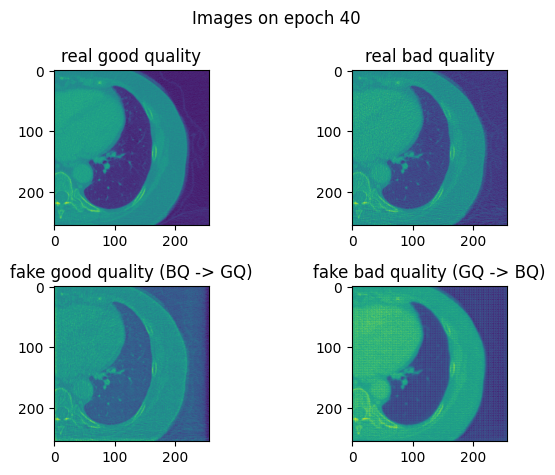

average PSNR for epoch 40 is 23.7529239654541


  0%|          | 0/120 [00:00<?, ?it/s]

average PSNR for epoch 41 is 24.7259521484375


  0%|          | 0/120 [00:00<?, ?it/s]

average PSNR for epoch 42 is 27.47264289855957


  0%|          | 0/120 [00:00<?, ?it/s]

average PSNR for epoch 43 is 23.33816909790039


  0%|          | 0/120 [00:00<?, ?it/s]

average PSNR for epoch 44 is 21.78829002380371


  0%|          | 0/120 [00:00<?, ?it/s]

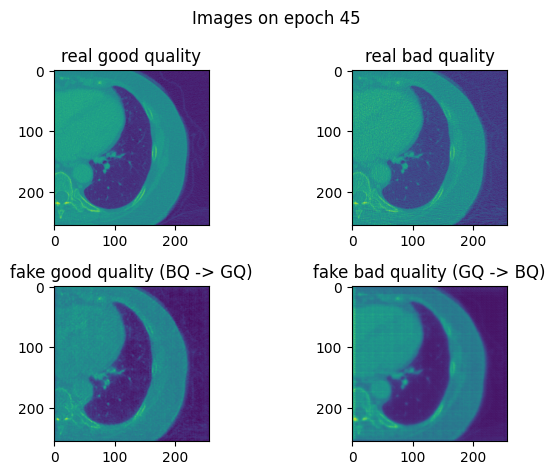

average PSNR for epoch 45 is 25.312149047851562


  0%|          | 0/120 [00:00<?, ?it/s]

average PSNR for epoch 46 is 25.83646011352539


  0%|          | 0/120 [00:00<?, ?it/s]

average PSNR for epoch 47 is 24.50130844116211


  0%|          | 0/120 [00:00<?, ?it/s]

average PSNR for epoch 48 is 27.081544876098633


  0%|          | 0/120 [00:00<?, ?it/s]

average PSNR for epoch 49 is 18.960542678833008


  0%|          | 0/120 [00:00<?, ?it/s]

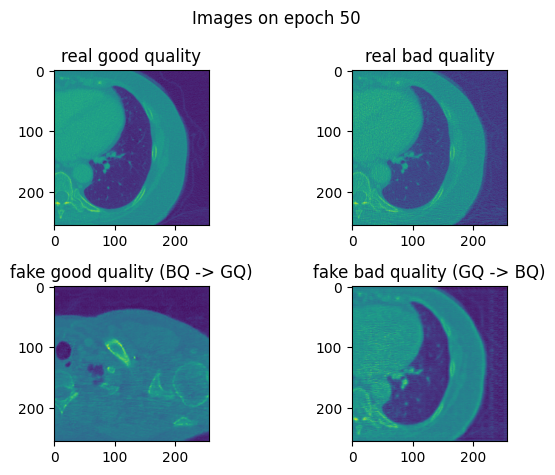

average PSNR for epoch 50 is 26.128015518188477


  0%|          | 0/120 [00:00<?, ?it/s]

average PSNR for epoch 51 is 25.1513614654541


  0%|          | 0/120 [00:00<?, ?it/s]

average PSNR for epoch 52 is 25.59566879272461


  0%|          | 0/120 [00:00<?, ?it/s]

average PSNR for epoch 53 is 28.053905487060547


  0%|          | 0/120 [00:00<?, ?it/s]

average PSNR for epoch 54 is 27.322065353393555


  0%|          | 0/120 [00:00<?, ?it/s]

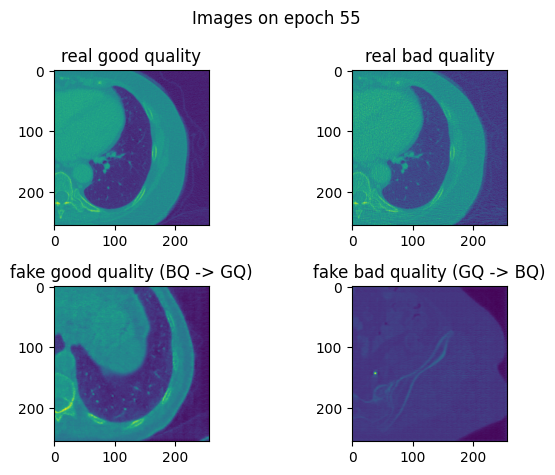

average PSNR for epoch 55 is 26.699758529663086


  0%|          | 0/120 [00:00<?, ?it/s]

average PSNR for epoch 56 is 26.207639694213867


  0%|          | 0/120 [00:00<?, ?it/s]

average PSNR for epoch 57 is 27.457704544067383


  0%|          | 0/120 [00:00<?, ?it/s]

average PSNR for epoch 58 is 26.2347412109375


  0%|          | 0/120 [00:00<?, ?it/s]

average PSNR for epoch 59 is 26.367536544799805


  0%|          | 0/120 [00:00<?, ?it/s]

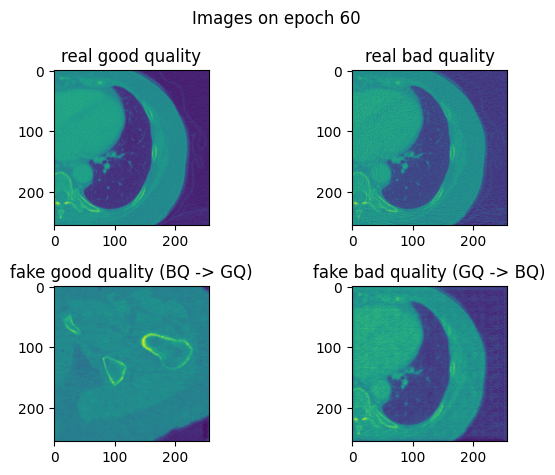

average PSNR for epoch 60 is 26.060684204101562


  0%|          | 0/120 [00:00<?, ?it/s]

average PSNR for epoch 61 is 25.474336624145508


  0%|          | 0/120 [00:00<?, ?it/s]

average PSNR for epoch 62 is 25.750072479248047


  0%|          | 0/120 [00:00<?, ?it/s]

average PSNR for epoch 63 is 28.574390411376953


  0%|          | 0/120 [00:00<?, ?it/s]

average PSNR for epoch 64 is 27.778703689575195


  0%|          | 0/120 [00:00<?, ?it/s]

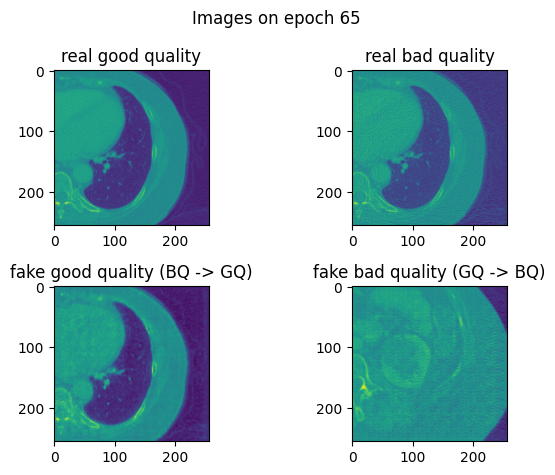

average PSNR for epoch 65 is 27.53012466430664


  0%|          | 0/120 [00:00<?, ?it/s]

average PSNR for epoch 66 is 27.403179168701172


  0%|          | 0/120 [00:00<?, ?it/s]

average PSNR for epoch 67 is 16.66131591796875


  0%|          | 0/120 [00:00<?, ?it/s]

average PSNR for epoch 68 is 26.2254695892334


  0%|          | 0/120 [00:00<?, ?it/s]

average PSNR for epoch 69 is 28.796306610107422


  0%|          | 0/120 [00:00<?, ?it/s]

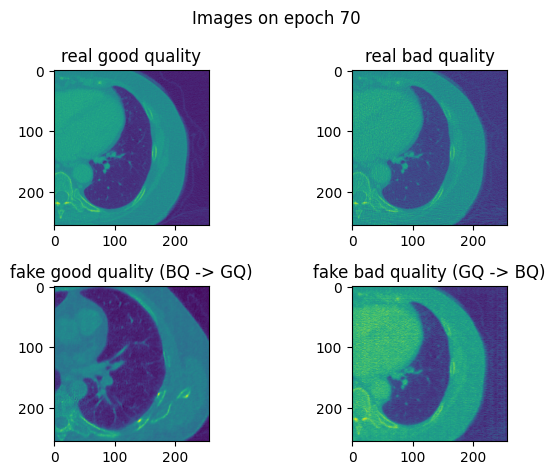

average PSNR for epoch 70 is 26.786489486694336


  0%|          | 0/120 [00:00<?, ?it/s]

average PSNR for epoch 71 is 25.604679107666016


  0%|          | 0/120 [00:00<?, ?it/s]

average PSNR for epoch 72 is 26.778499603271484


  0%|          | 0/120 [00:00<?, ?it/s]

average PSNR for epoch 73 is 27.161418914794922


  0%|          | 0/120 [00:00<?, ?it/s]

average PSNR for epoch 74 is 27.128887176513672


  0%|          | 0/120 [00:00<?, ?it/s]

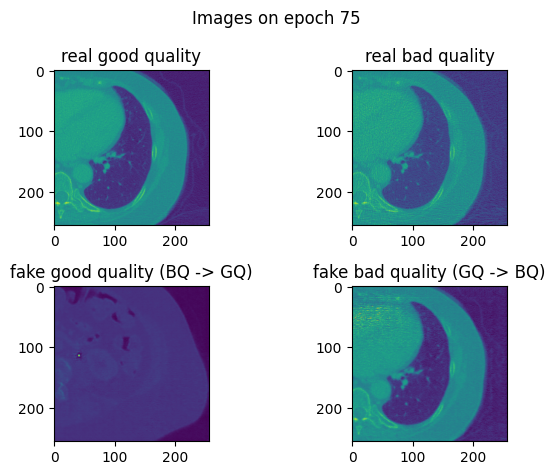

average PSNR for epoch 75 is 25.960506439208984


  0%|          | 0/120 [00:00<?, ?it/s]

average PSNR for epoch 76 is 23.870397567749023


  0%|          | 0/120 [00:00<?, ?it/s]

average PSNR for epoch 77 is 26.391660690307617


  0%|          | 0/120 [00:00<?, ?it/s]

average PSNR for epoch 78 is 24.56527328491211


  0%|          | 0/120 [00:00<?, ?it/s]

average PSNR for epoch 79 is 23.55594253540039


  0%|          | 0/120 [00:00<?, ?it/s]

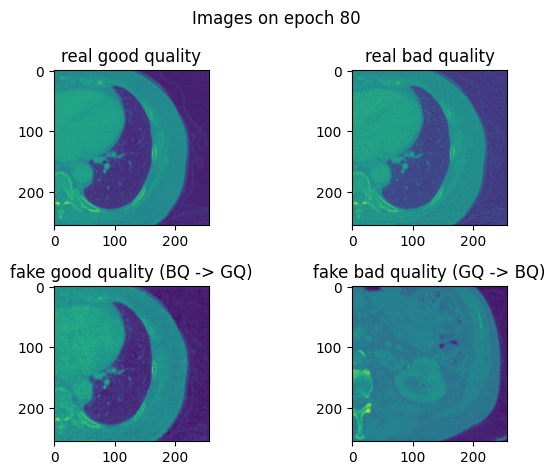

average PSNR for epoch 80 is 25.475276947021484


  0%|          | 0/120 [00:00<?, ?it/s]

average PSNR for epoch 81 is 24.833328247070312


  0%|          | 0/120 [00:00<?, ?it/s]

average PSNR for epoch 82 is 24.21158790588379


  0%|          | 0/120 [00:00<?, ?it/s]

average PSNR for epoch 83 is 24.552932739257812


  0%|          | 0/120 [00:00<?, ?it/s]

average PSNR for epoch 84 is 25.716983795166016


  0%|          | 0/120 [00:00<?, ?it/s]

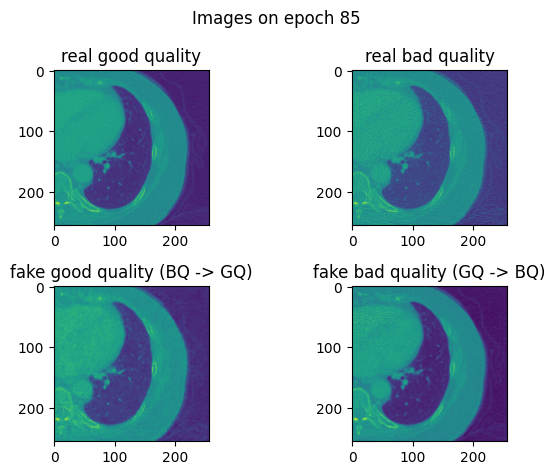

average PSNR for epoch 85 is 25.307661056518555


  0%|          | 0/120 [00:00<?, ?it/s]

average PSNR for epoch 86 is 25.32325553894043


  0%|          | 0/120 [00:00<?, ?it/s]

average PSNR for epoch 87 is 25.119571685791016


  0%|          | 0/120 [00:00<?, ?it/s]

average PSNR for epoch 88 is 25.337860107421875


  0%|          | 0/120 [00:00<?, ?it/s]

average PSNR for epoch 89 is 25.14872932434082


  0%|          | 0/120 [00:00<?, ?it/s]

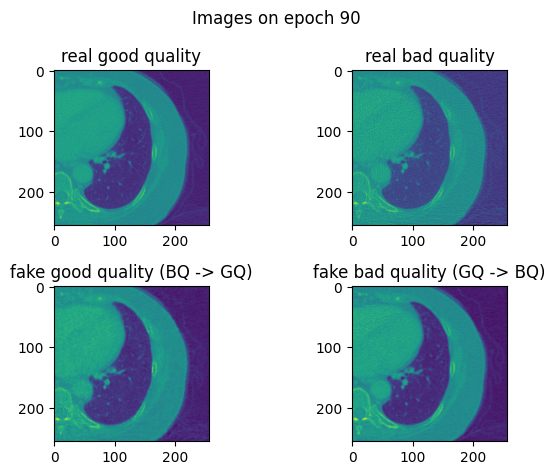

average PSNR for epoch 90 is 25.630935668945312


  0%|          | 0/120 [00:00<?, ?it/s]

average PSNR for epoch 91 is 25.669952392578125


  0%|          | 0/120 [00:00<?, ?it/s]

average PSNR for epoch 92 is 25.75864601135254


  0%|          | 0/120 [00:00<?, ?it/s]

average PSNR for epoch 93 is 25.84197998046875


  0%|          | 0/120 [00:00<?, ?it/s]

average PSNR for epoch 94 is 25.850749969482422


  0%|          | 0/120 [00:00<?, ?it/s]

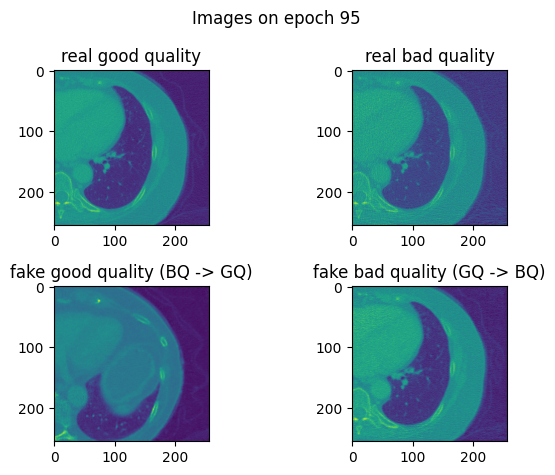

average PSNR for epoch 95 is 25.87562370300293


  0%|          | 0/120 [00:00<?, ?it/s]

average PSNR for epoch 96 is 25.959228515625


  0%|          | 0/120 [00:00<?, ?it/s]

average PSNR for epoch 97 is 26.031795501708984


  0%|          | 0/120 [00:00<?, ?it/s]

average PSNR for epoch 98 is 26.036386489868164


  0%|          | 0/120 [00:00<?, ?it/s]

average PSNR for epoch 99 is 26.07320213317871


In [ ]:
history, D_A_ct, D_B_ct, G_A2B_ct, G_B2A_ct = train_model(D_A_ct, D_B_ct, G_A2B_ct, G_B2A_ct, ct_trainLoader, ct_validLoader, batch_size, epochs, './ct_final_result', history_ct)

Видим периодические "глюки" модели. Улучшающий качество GAN увеличивает контрастность.

Проверим, как ведет себя модель на батче из другого датасета:

In [ ]:
totalPSNR = 0
stepValidcnt = 0
with torch.no_grad():
    G_B2A_ct.eval() #B: qd   A: fd
    G_B2A_ct.to(DEVICE)
    for (realA,realB) in us_trainLoader:
        (realA,realB)=(realA.to(DEVICE),realB.to(DEVICE))
        fakeA=G_B2A_ct(realB)

        fakeA=normalize(fakeA,zero2one=True)
        realA=normalize(realA,zero2one=True)
        batch_psnr=psnr(fakeA,realA)
        totalPSNR+=batch_psnr
        stepValidcnt+=1
print(batch_psnr)

tensor(16.2881, device='cuda:0')


Видим, что PSNR не очень высокий, датасеты довольно разные.

Посмотрим больше примеров на КТ датасете:

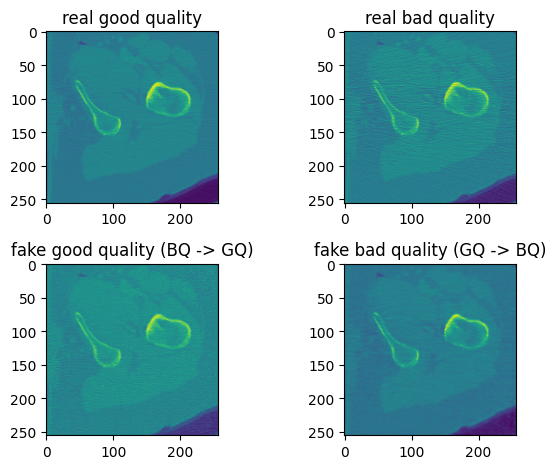

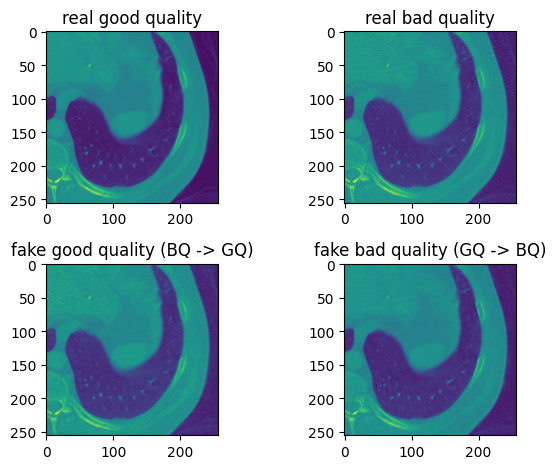

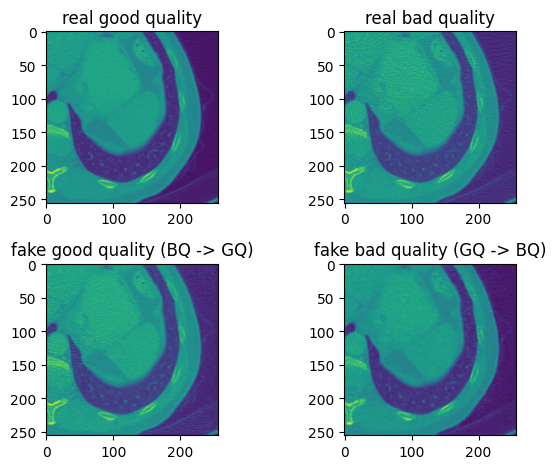

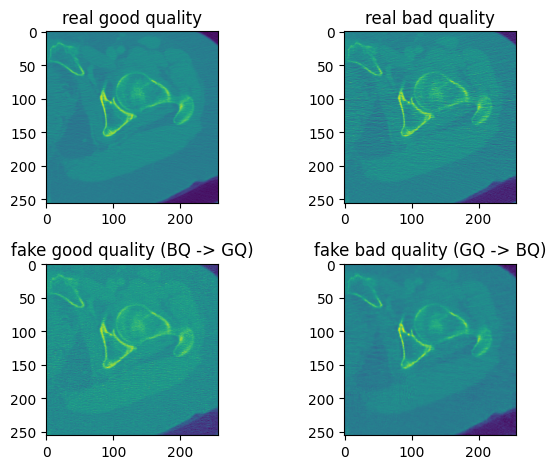

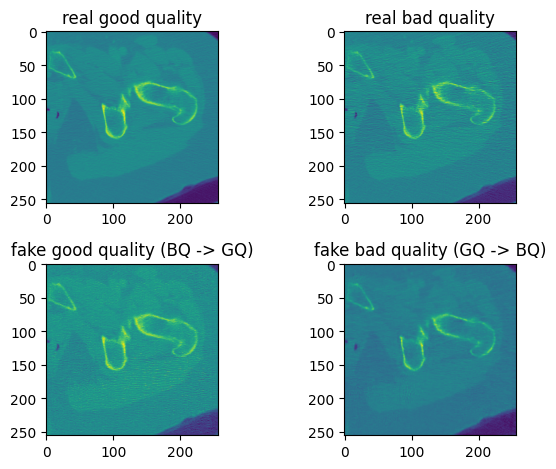

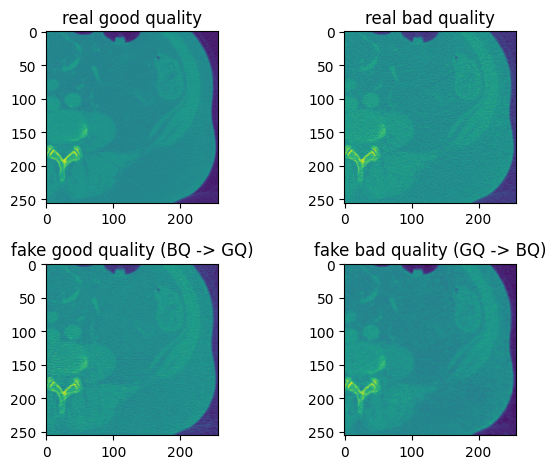

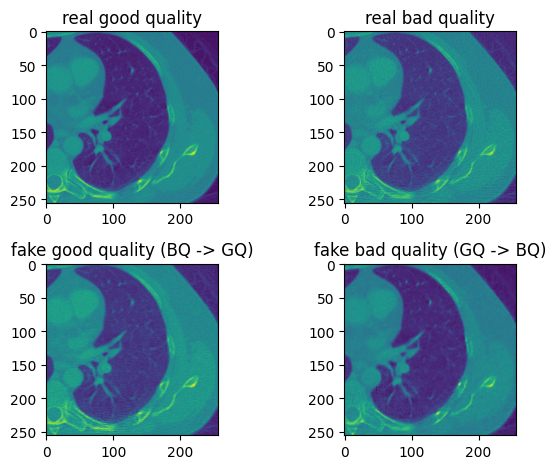

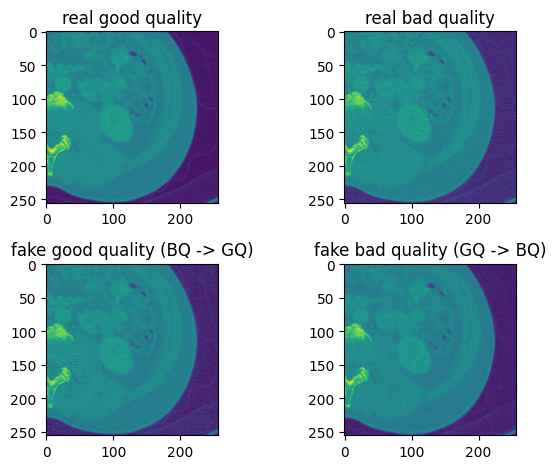

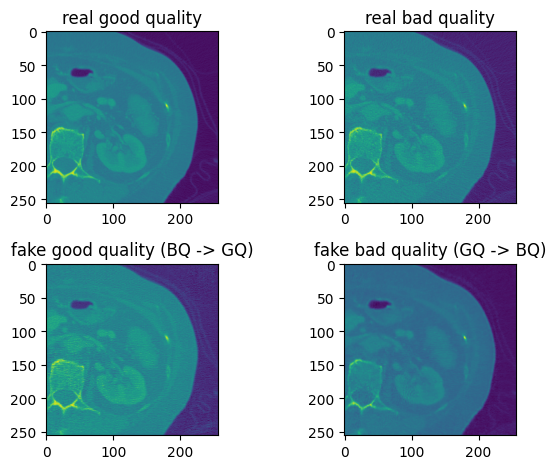

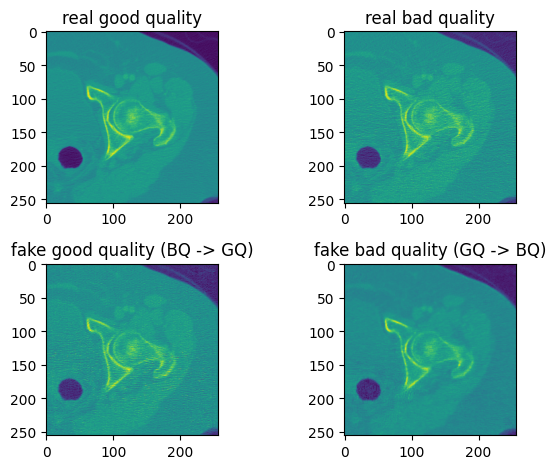

In [ ]:
a_preds = G_A2B_ct.cpu()(a)
b_preds = G_B2A_ct.cpu()(b)

for i in range(10):
    fig, axs = plt.subplots(2, 2)
    axs[0, 0].imshow(a[i][0].cpu().detach())
    axs[0, 0].set_title('real good quality')
    axs[0, 1].imshow(b[i][0].cpu().detach())
    axs[0, 1].set_title('real bad quality')
    axs[1, 0].imshow(a_preds[i][0].cpu().detach())
    axs[1, 0].set_title('fake good quality (BQ -> GQ)')
    axs[1, 1].imshow(b_preds[i][0].cpu().detach())
    axs[1, 1].set_title('fake bad quality (GQ -> BQ)')
    plt.tight_layout()
    plt.show()

Видим, что галлюцинации модели происходят не так часто (по крайней мере, не каждый 2-й случай), общая структура изображения сохраняется.

Посмотрим метрики обучения:

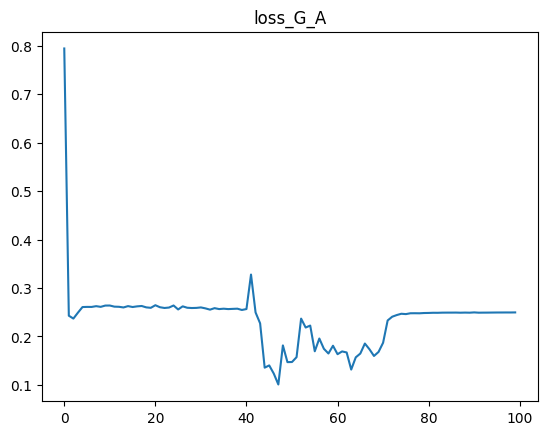

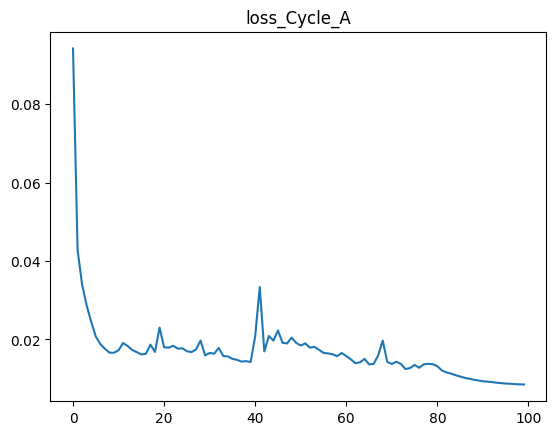

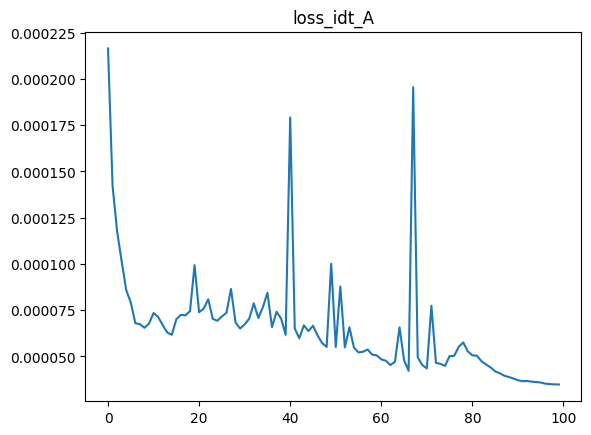

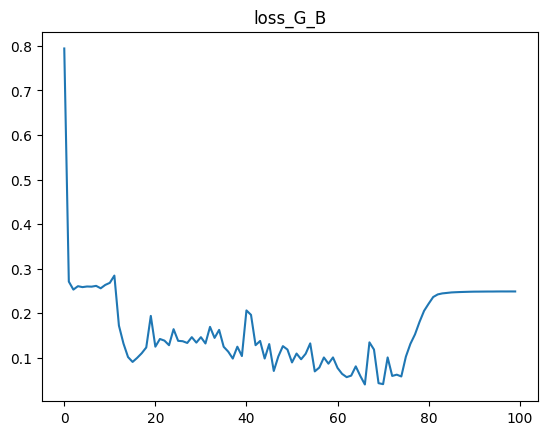

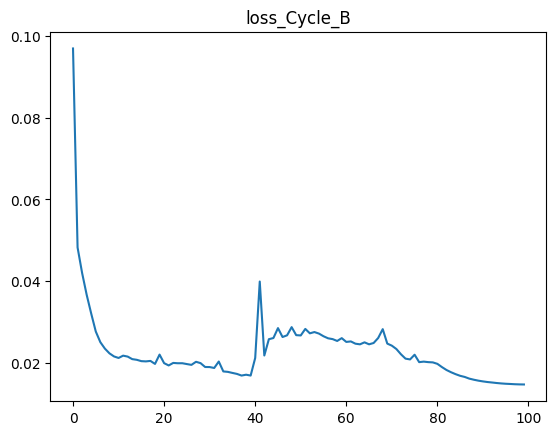

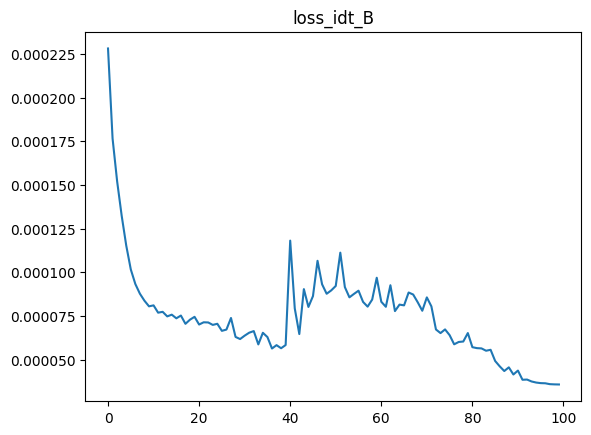

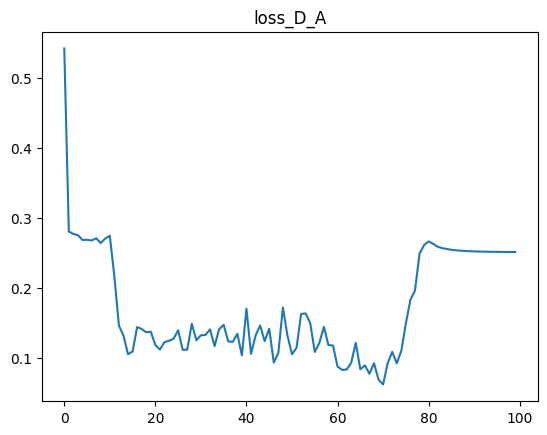

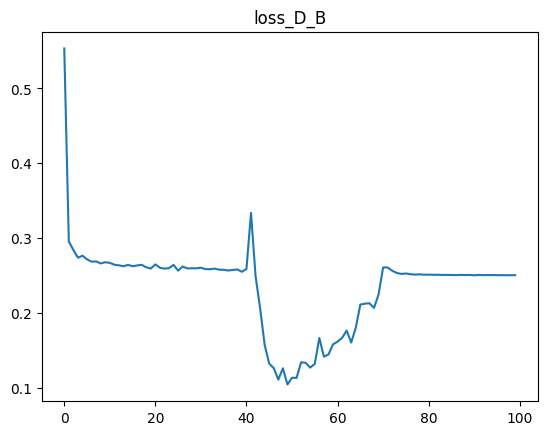

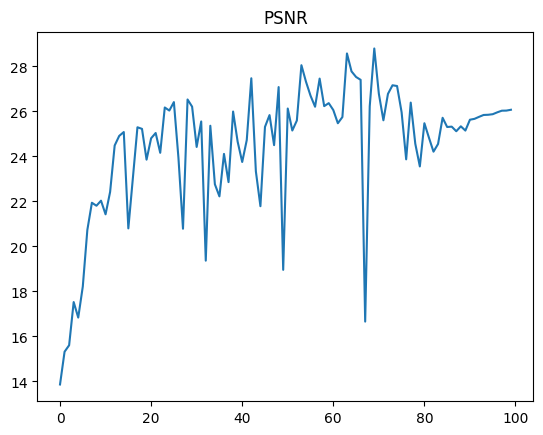

In [ ]:
for key in history_ct.keys():
    plt.title(key)
    plt.plot([i for i in range(epochs)], history_ct[key])
    plt.show()

Обучение шло нестабильно, на 40й эпохе произошел скачок метрик (на тестовом изображении не виден). Если ключевой метрикой считать PSNR, то ее изменнеие также довольно стохастично, хотя в целом и имеет тенденцию к росту.

## US train

Проведем те же операции с другим датасетом. Из-за специфики, немного поменяем веса, увеличим его на L1 loss.

In [ ]:
norm_type='batch'
epochs=100
lambda_A=10.0
lambda_B=10.0
lr=0.0002
ngf=64
ndf=64
use_droplayer=False
batch_size=16
norm_layer = functools.partial(nn.InstanceNorm2d, affine=False, track_running_stats=False)
DEVICE='cuda' if torch.cuda.is_available() else 'cpu'

In [ ]:
G_A2B_us=UNetGenerator(in_c=1,out_c=1,ngf=ngf,norm_layer=norm_layer,use_drop=use_droplayer)
G_B2A_us=UNetGenerator(in_c=1,out_c=1,ngf=ngf,norm_layer=norm_layer,use_drop=use_droplayer)

D_A_us=Discriminator(in_c=1,ndf=ndf,n_layers=3,norm_layer=norm_layer)
D_B_us=Discriminator(in_c=1,ndf=ndf,n_layers=3,norm_layer=norm_layer)

In [ ]:
G_A2B_us.to(DEVICE)
G_B2A_us.to(DEVICE)
D_A_us.to(DEVICE)
D_B_us.to(DEVICE)

G_A2B_us.apply(init_weight)
G_B2A_us.apply(init_weight)
D_A_us.apply(init_weight)
D_B_us.apply(init_weight)

if torch.cuda.device_count() > 1:
    print('training with {} GPUs'.format(torch.cuda.device_count()))
    G_A2B_us=torch.nn.DataParallel(G_A2B_us)
    G_B2A_us=torch.nn.DataParallel(G_B2A_us)
    D_A_us=torch.nn.DataParallel(D_A_us)
    D_B_us=torch.nn.DataParallel(D_B_us)

In [ ]:
lossGAN=nn.MSELoss()
lossCycle=nn.L1Loss()
lossIdentity=nn.L1Loss()

In [ ]:
psnr=PeakSignalNoiseRatio(data_range=1,dim=[-1,-2,-3])

trainTransforms=transforms.Compose([
    transforms.RandomCrop((256,256)),
])

us_trainDataset=makeDataset_us('/content/us_data', 'us', trainTransforms)
us_validDataset=makeDataset_us('/content/us_data', 'us', transform=None, mode='test')

us_trainLoader=DataLoader(us_trainDataset,batch_size=batch_size,shuffle=True)
us_validLoader=DataLoader(us_validDataset,batch_size=batch_size,shuffle=False)


optGAN_us=torch.optim.Adam(itertools.chain(G_A2B_us.parameters(),G_B2A_us.parameters()),lr=lr,betas=(0.5,0.999))
optD_us=torch.optim.Adam(itertools.chain(D_A_us.parameters(),D_B_us.parameters()),lr=lr,betas=(0.5,0.999))

lr_schedular_G=torch.optim.lr_scheduler.LambdaLR(optGAN_us,lr_lambda=LambdaLR(epochs).step)
lr_schedular_D=torch.optim.lr_scheduler.LambdaLR(optD_us,lr_lambda=LambdaLR(epochs).step)
history_us={'loss_G_A':[],'loss_Cycle_A':[],'loss_idt_A':[],
         'loss_G_B':[],'loss_Cycle_B':[],'loss_idt_B':[],'loss_D_A':[],'loss_D_B':[],'PSNR':[]}

if not os.path.exists('./us_final_result'):
    os.makedirs('./us_final_result')
if not os.path.exists('./us_final_result/GAN_FD_to_QD'):
    os.makedirs('./us_final_result/GAN_FD_to_QD')
if not os.path.exists('./us_final_result/GAN_QD_to_FD'):
    os.makedirs('./us_final_result/GAN_QD_to_FD')
if not os.path.exists('./us_final_result/Discriminator_A'):
    os.makedirs('./us_final_result/Discriminator_A')
if not os.path.exists('./us_final_result/Discriminator_B'):
    os.makedirs('./us_final_result/Discriminator_B')


/usr/local/lib/python3.11/dist-packages/torchmetrics/utilities/prints.py:62: FutureWarning: Importing `PeakSignalNoiseRatio` from `torchmetrics` was deprecated and will be removed in 2.0. Import `PeakSignalNoiseRatio` from `torchmetrics.image` instead.
  _future_warning(


In [ ]:
history_us={'loss_G_A':[],'loss_Cycle_A':[],'loss_idt_A':[],
         'loss_G_B':[],'loss_Cycle_B':[],'loss_idt_B':[],'loss_D_A':[],'loss_D_B':[],'PSNR':[]}

  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

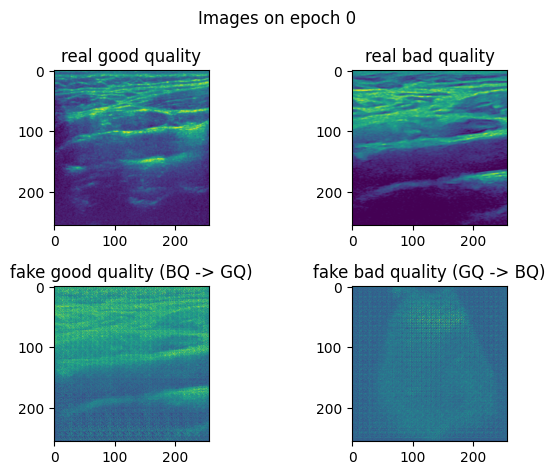

average PSNR for epoch 0 is 13.357170104980469


  0%|          | 0/50 [00:00<?, ?it/s]

average PSNR for epoch 1 is 14.3237886428833


  0%|          | 0/50 [00:00<?, ?it/s]

average PSNR for epoch 2 is 13.798027038574219


  0%|          | 0/50 [00:00<?, ?it/s]

average PSNR for epoch 3 is 14.069218635559082


  0%|          | 0/50 [00:00<?, ?it/s]

average PSNR for epoch 4 is 14.246925354003906


  0%|          | 0/50 [00:00<?, ?it/s]

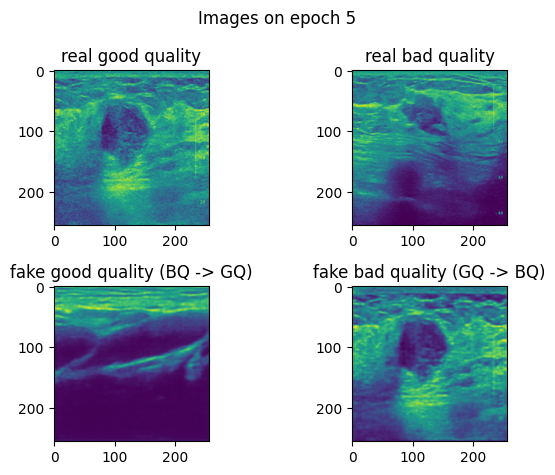

average PSNR for epoch 5 is 14.087867736816406


  0%|          | 0/50 [00:00<?, ?it/s]

average PSNR for epoch 6 is 14.381011962890625


  0%|          | 0/50 [00:00<?, ?it/s]

average PSNR for epoch 7 is 14.280020713806152


  0%|          | 0/50 [00:00<?, ?it/s]

average PSNR for epoch 8 is 14.26612663269043


  0%|          | 0/50 [00:00<?, ?it/s]

average PSNR for epoch 9 is 14.257765769958496


  0%|          | 0/50 [00:00<?, ?it/s]

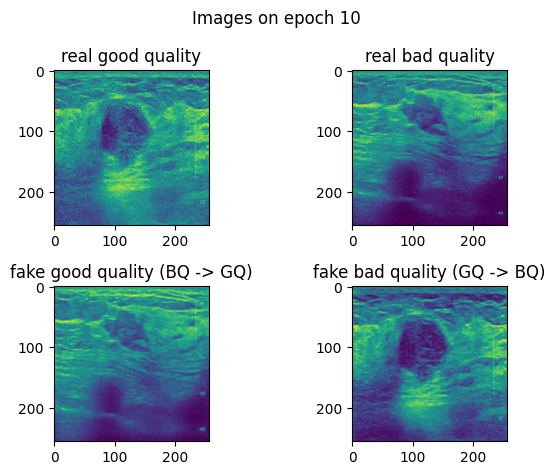

average PSNR for epoch 10 is 14.443116188049316


  0%|          | 0/50 [00:00<?, ?it/s]

average PSNR for epoch 11 is 14.594691276550293


  0%|          | 0/50 [00:00<?, ?it/s]

average PSNR for epoch 12 is 14.679444313049316


  0%|          | 0/50 [00:00<?, ?it/s]

average PSNR for epoch 13 is 14.465315818786621


  0%|          | 0/50 [00:00<?, ?it/s]

average PSNR for epoch 14 is 14.519643783569336


  0%|          | 0/50 [00:00<?, ?it/s]

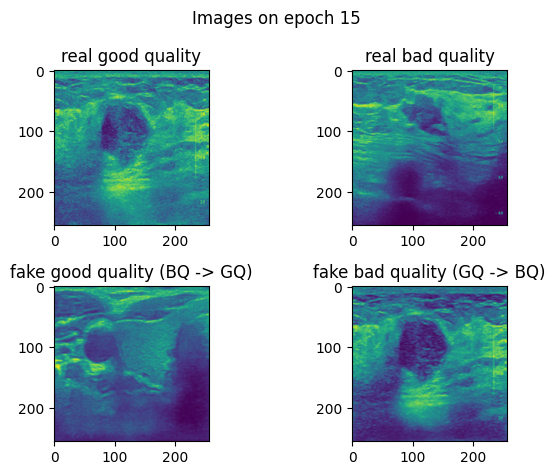

average PSNR for epoch 15 is 14.554414749145508


  0%|          | 0/50 [00:00<?, ?it/s]

average PSNR for epoch 16 is 14.413671493530273


  0%|          | 0/50 [00:00<?, ?it/s]

average PSNR for epoch 17 is 14.518098831176758


  0%|          | 0/50 [00:00<?, ?it/s]

average PSNR for epoch 18 is 14.469504356384277


  0%|          | 0/50 [00:00<?, ?it/s]

average PSNR for epoch 19 is 14.54954719543457


  0%|          | 0/50 [00:00<?, ?it/s]

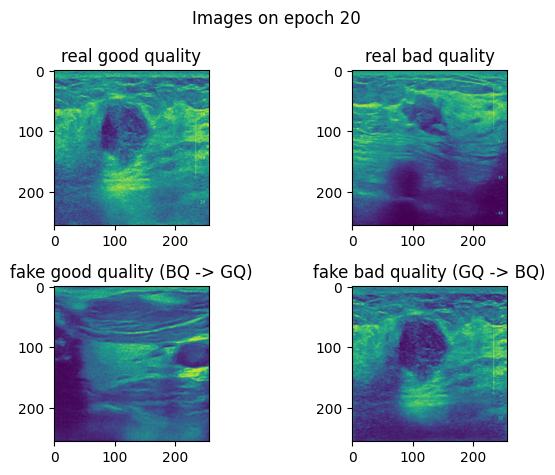

average PSNR for epoch 20 is 14.270516395568848


  0%|          | 0/50 [00:00<?, ?it/s]

average PSNR for epoch 21 is 14.064034461975098


  0%|          | 0/50 [00:00<?, ?it/s]

average PSNR for epoch 22 is 13.973166465759277


  0%|          | 0/50 [00:00<?, ?it/s]

average PSNR for epoch 23 is 13.798340797424316


  0%|          | 0/50 [00:00<?, ?it/s]

average PSNR for epoch 24 is 13.936933517456055


  0%|          | 0/50 [00:00<?, ?it/s]

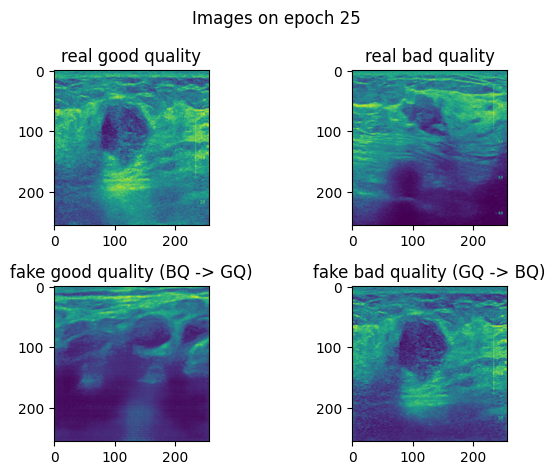

average PSNR for epoch 25 is 14.345331192016602


  0%|          | 0/50 [00:00<?, ?it/s]

average PSNR for epoch 26 is 14.333125114440918


  0%|          | 0/50 [00:00<?, ?it/s]

average PSNR for epoch 27 is 13.871696472167969


  0%|          | 0/50 [00:00<?, ?it/s]

average PSNR for epoch 28 is 14.120976448059082


  0%|          | 0/50 [00:00<?, ?it/s]

average PSNR for epoch 29 is 14.11205005645752


  0%|          | 0/50 [00:00<?, ?it/s]

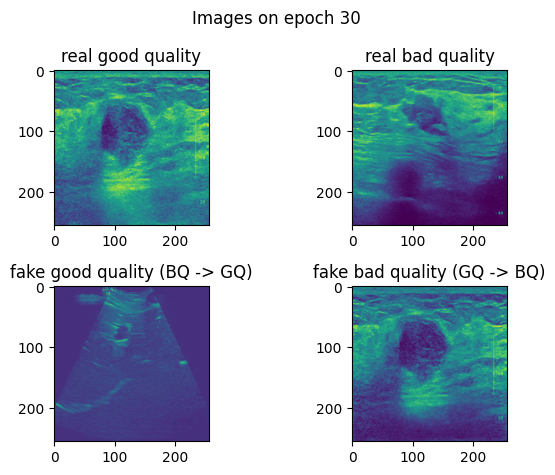

average PSNR for epoch 30 is 13.952899932861328


  0%|          | 0/50 [00:00<?, ?it/s]

average PSNR for epoch 31 is 13.852187156677246


  0%|          | 0/50 [00:00<?, ?it/s]

average PSNR for epoch 32 is 14.053000450134277


  0%|          | 0/50 [00:00<?, ?it/s]

average PSNR for epoch 33 is 14.160985946655273


  0%|          | 0/50 [00:00<?, ?it/s]

average PSNR for epoch 34 is 14.081717491149902


  0%|          | 0/50 [00:00<?, ?it/s]

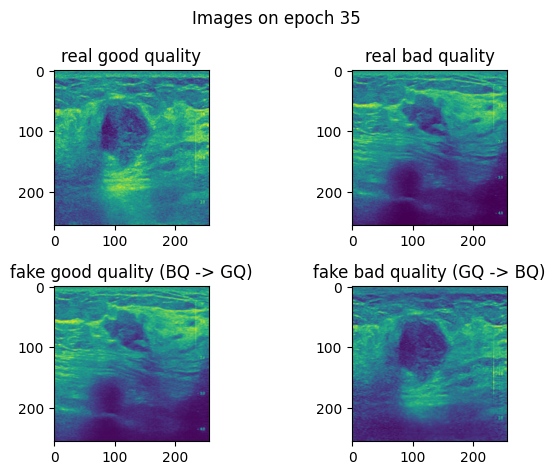

average PSNR for epoch 35 is 14.117934226989746


  0%|          | 0/50 [00:00<?, ?it/s]

average PSNR for epoch 36 is 14.161781311035156


  0%|          | 0/50 [00:00<?, ?it/s]

average PSNR for epoch 37 is 14.254158020019531


  0%|          | 0/50 [00:00<?, ?it/s]

average PSNR for epoch 38 is 13.677901268005371


  0%|          | 0/50 [00:00<?, ?it/s]

average PSNR for epoch 39 is 14.397974967956543


  0%|          | 0/50 [00:00<?, ?it/s]

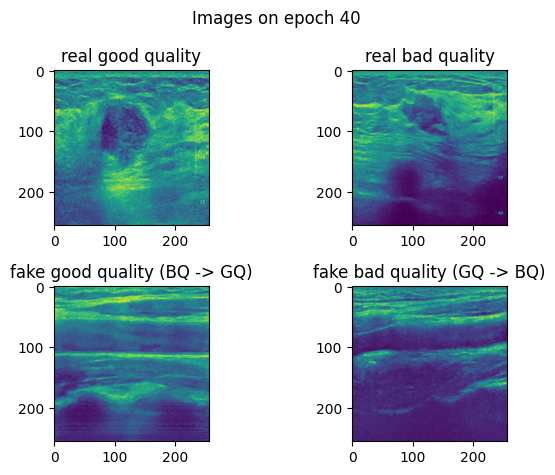

average PSNR for epoch 40 is 13.826299667358398


  0%|          | 0/50 [00:00<?, ?it/s]

average PSNR for epoch 41 is 13.828043937683105


  0%|          | 0/50 [00:00<?, ?it/s]

average PSNR for epoch 42 is 14.225335121154785


  0%|          | 0/50 [00:00<?, ?it/s]

average PSNR for epoch 43 is 14.228323936462402


  0%|          | 0/50 [00:00<?, ?it/s]

average PSNR for epoch 44 is 14.162679672241211


  0%|          | 0/50 [00:00<?, ?it/s]

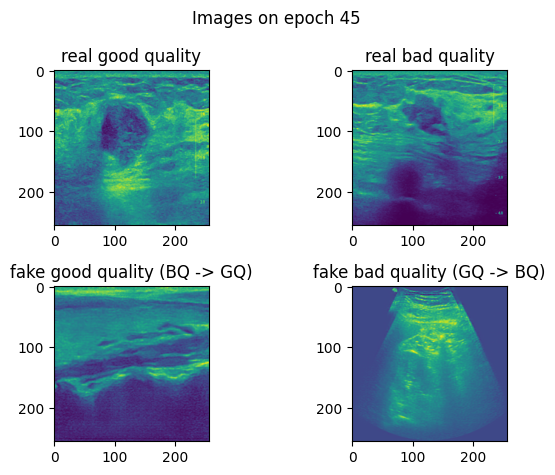

average PSNR for epoch 45 is 14.013958930969238


  0%|          | 0/50 [00:00<?, ?it/s]

average PSNR for epoch 46 is 13.865721702575684


  0%|          | 0/50 [00:00<?, ?it/s]

average PSNR for epoch 47 is 14.2118501663208


  0%|          | 0/50 [00:00<?, ?it/s]

average PSNR for epoch 48 is 13.919870376586914


  0%|          | 0/50 [00:00<?, ?it/s]

average PSNR for epoch 49 is 13.811607360839844


  0%|          | 0/50 [00:00<?, ?it/s]

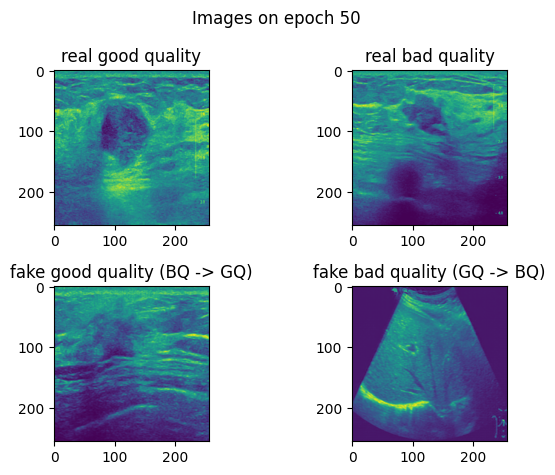

average PSNR for epoch 50 is 13.961177825927734


  0%|          | 0/50 [00:00<?, ?it/s]

average PSNR for epoch 51 is 14.517217636108398


  0%|          | 0/50 [00:00<?, ?it/s]

average PSNR for epoch 52 is 13.844810485839844


  0%|          | 0/50 [00:00<?, ?it/s]

average PSNR for epoch 53 is 13.503486633300781


  0%|          | 0/50 [00:00<?, ?it/s]

average PSNR for epoch 54 is 13.9335298538208


  0%|          | 0/50 [00:00<?, ?it/s]

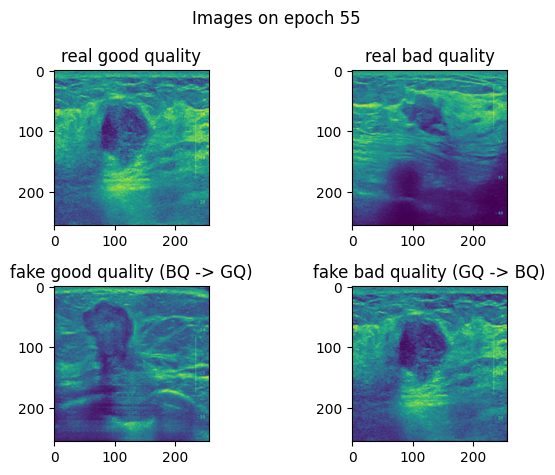

average PSNR for epoch 55 is 14.356145858764648


  0%|          | 0/50 [00:00<?, ?it/s]

average PSNR for epoch 56 is 13.981287956237793


  0%|          | 0/50 [00:00<?, ?it/s]

average PSNR for epoch 57 is 14.049771308898926


  0%|          | 0/50 [00:00<?, ?it/s]

average PSNR for epoch 58 is 13.865232467651367


  0%|          | 0/50 [00:00<?, ?it/s]

average PSNR for epoch 59 is 14.375937461853027


  0%|          | 0/50 [00:00<?, ?it/s]

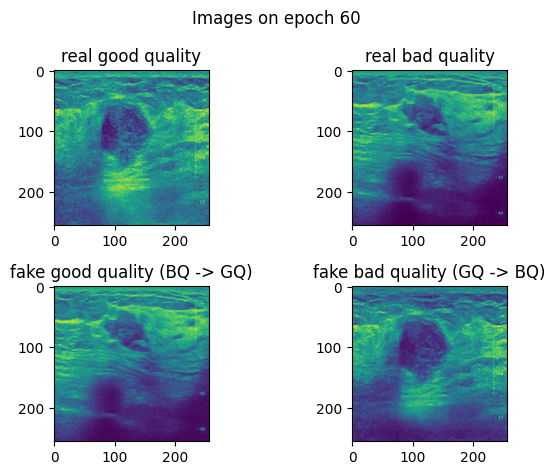

average PSNR for epoch 60 is 13.522004127502441


  0%|          | 0/50 [00:00<?, ?it/s]

average PSNR for epoch 61 is 13.773155212402344


  0%|          | 0/50 [00:00<?, ?it/s]

average PSNR for epoch 62 is 14.097426414489746


  0%|          | 0/50 [00:00<?, ?it/s]

average PSNR for epoch 63 is 14.105280876159668


  0%|          | 0/50 [00:00<?, ?it/s]

average PSNR for epoch 64 is 14.387948989868164


  0%|          | 0/50 [00:00<?, ?it/s]

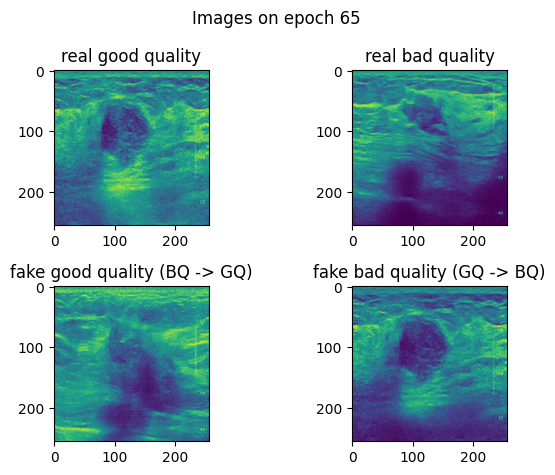

average PSNR for epoch 65 is 14.213128089904785


  0%|          | 0/50 [00:00<?, ?it/s]

average PSNR for epoch 66 is 14.439908981323242


  0%|          | 0/50 [00:00<?, ?it/s]

average PSNR for epoch 67 is 14.20386791229248


  0%|          | 0/50 [00:00<?, ?it/s]

average PSNR for epoch 68 is 14.248230934143066


  0%|          | 0/50 [00:00<?, ?it/s]

average PSNR for epoch 69 is 14.29935073852539


  0%|          | 0/50 [00:00<?, ?it/s]

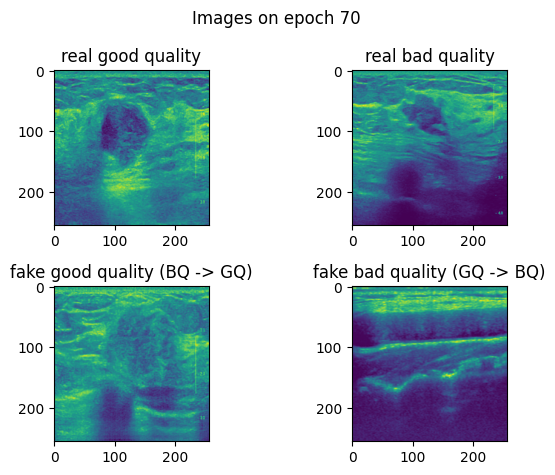

average PSNR for epoch 70 is 14.03128719329834


  0%|          | 0/50 [00:00<?, ?it/s]

average PSNR for epoch 71 is 13.68216323852539


  0%|          | 0/50 [00:00<?, ?it/s]

average PSNR for epoch 72 is 14.33403491973877


  0%|          | 0/50 [00:00<?, ?it/s]

average PSNR for epoch 73 is 14.31569766998291


  0%|          | 0/50 [00:00<?, ?it/s]

average PSNR for epoch 74 is 14.080496788024902


  0%|          | 0/50 [00:00<?, ?it/s]

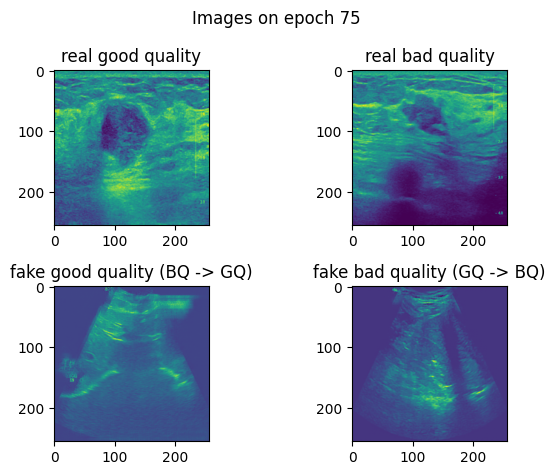

average PSNR for epoch 75 is 13.667986869812012


  0%|          | 0/50 [00:00<?, ?it/s]

average PSNR for epoch 76 is 14.287723541259766


  0%|          | 0/50 [00:00<?, ?it/s]

average PSNR for epoch 77 is 13.923720359802246


  0%|          | 0/50 [00:00<?, ?it/s]

average PSNR for epoch 78 is 14.260948181152344


  0%|          | 0/50 [00:00<?, ?it/s]

average PSNR for epoch 79 is 14.297513961791992


  0%|          | 0/50 [00:00<?, ?it/s]

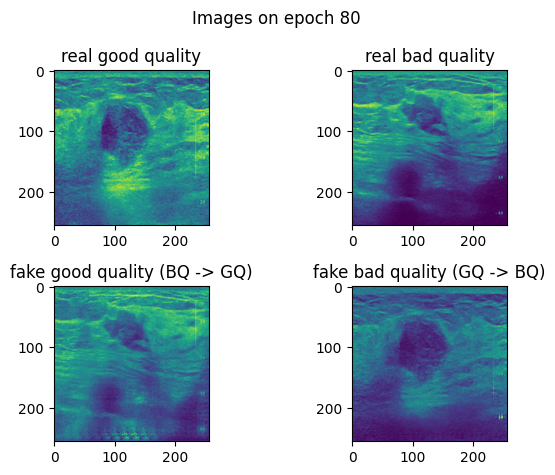

average PSNR for epoch 80 is 14.629585266113281


  0%|          | 0/50 [00:00<?, ?it/s]

average PSNR for epoch 81 is 14.508878707885742


  0%|          | 0/50 [00:00<?, ?it/s]

average PSNR for epoch 82 is 14.526113510131836


  0%|          | 0/50 [00:00<?, ?it/s]

average PSNR for epoch 83 is 14.636582374572754


  0%|          | 0/50 [00:00<?, ?it/s]

average PSNR for epoch 84 is 14.51421070098877


  0%|          | 0/50 [00:00<?, ?it/s]

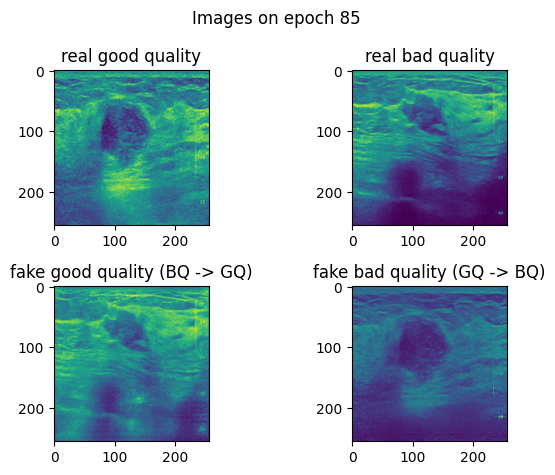

average PSNR for epoch 85 is 14.252700805664062


  0%|          | 0/50 [00:00<?, ?it/s]

average PSNR for epoch 86 is 14.469565391540527


  0%|          | 0/50 [00:00<?, ?it/s]

average PSNR for epoch 87 is 14.311427116394043


  0%|          | 0/50 [00:00<?, ?it/s]

average PSNR for epoch 88 is 14.309898376464844


  0%|          | 0/50 [00:00<?, ?it/s]

average PSNR for epoch 89 is 14.184255599975586


  0%|          | 0/50 [00:00<?, ?it/s]

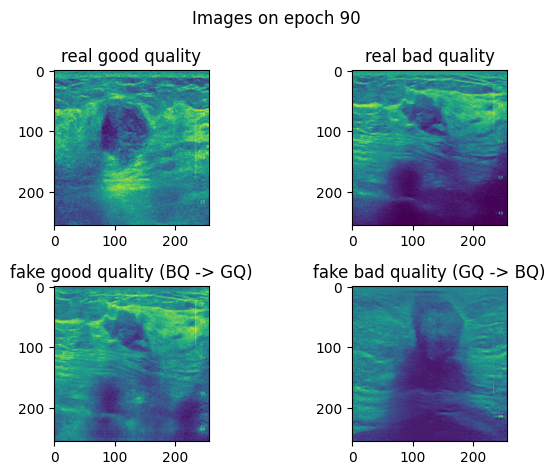

average PSNR for epoch 90 is 14.19443130493164


  0%|          | 0/50 [00:00<?, ?it/s]

average PSNR for epoch 91 is 14.273984909057617


  0%|          | 0/50 [00:00<?, ?it/s]

average PSNR for epoch 92 is 14.270011901855469


  0%|          | 0/50 [00:00<?, ?it/s]

average PSNR for epoch 93 is 14.305641174316406


  0%|          | 0/50 [00:00<?, ?it/s]

average PSNR for epoch 94 is 14.367135047912598


  0%|          | 0/50 [00:00<?, ?it/s]

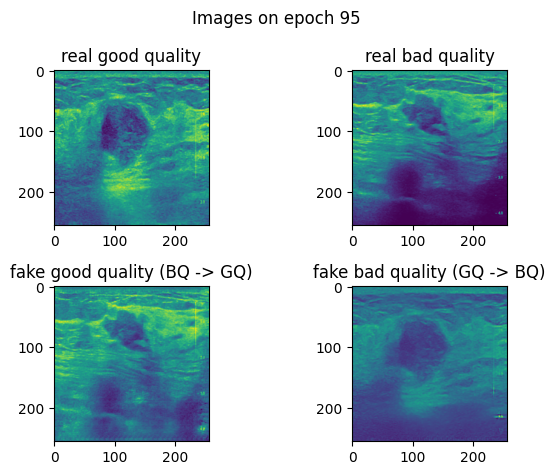

average PSNR for epoch 95 is 14.383670806884766


  0%|          | 0/50 [00:00<?, ?it/s]

average PSNR for epoch 96 is 14.377822875976562


  0%|          | 0/50 [00:00<?, ?it/s]

average PSNR for epoch 97 is 14.481514930725098


  0%|          | 0/50 [00:00<?, ?it/s]

average PSNR for epoch 98 is 14.526299476623535


  0%|          | 0/50 [00:00<?, ?it/s]

average PSNR for epoch 99 is 14.532145500183105


In [ ]:
history_us, D_A_us, D_B_us, G_A2B_us, G_B2A_us = train_model(D_A_us, D_B_us, G_A2B_us, G_B2A_us, us_trainLoader, us_validLoader, batch_size, epochs, result_dir='./us_final_result/', history=history_us, lambda_identity=10)

  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

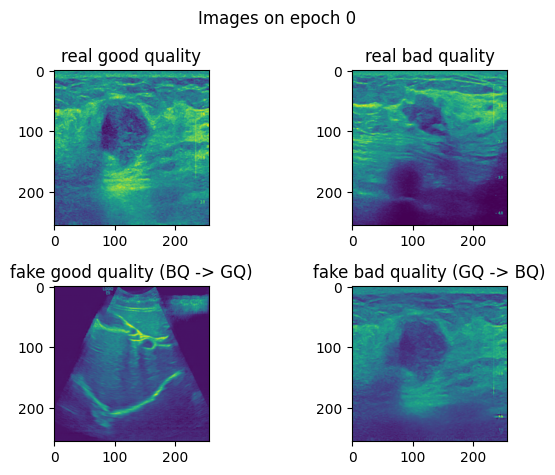

average PSNR for epoch 0 is 14.225820541381836


  0%|          | 0/50 [00:00<?, ?it/s]

average PSNR for epoch 1 is 14.176737785339355


  0%|          | 0/50 [00:00<?, ?it/s]

average PSNR for epoch 2 is 14.014668464660645


  0%|          | 0/50 [00:00<?, ?it/s]

average PSNR for epoch 3 is 14.35928726196289


  0%|          | 0/50 [00:00<?, ?it/s]

average PSNR for epoch 4 is 14.346710205078125


  0%|          | 0/50 [00:00<?, ?it/s]

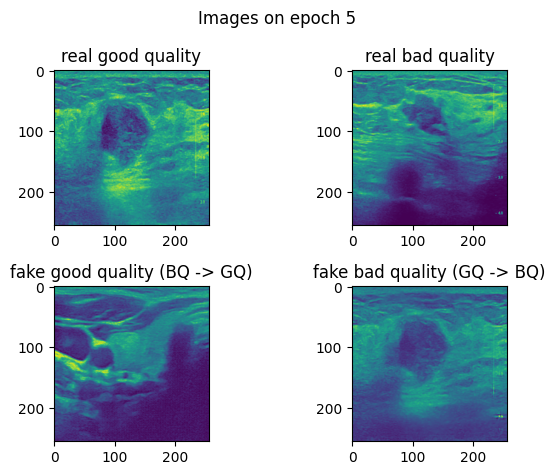

average PSNR for epoch 5 is 13.269930839538574


  0%|          | 0/50 [00:00<?, ?it/s]

average PSNR for epoch 6 is 13.60908317565918


  0%|          | 0/50 [00:00<?, ?it/s]

average PSNR for epoch 7 is 14.204497337341309


  0%|          | 0/50 [00:00<?, ?it/s]

average PSNR for epoch 8 is 14.20283317565918


  0%|          | 0/50 [00:00<?, ?it/s]

average PSNR for epoch 9 is 14.19779109954834


  0%|          | 0/50 [00:00<?, ?it/s]

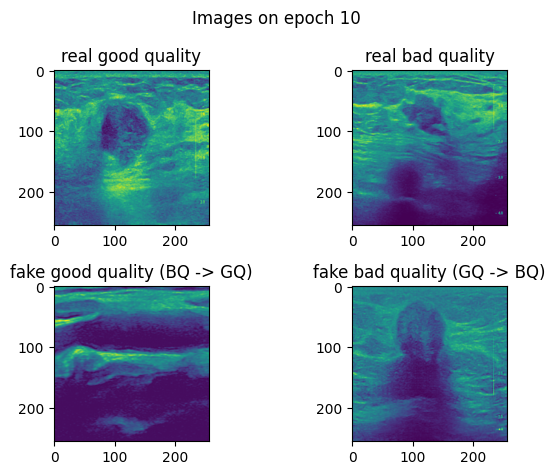

average PSNR for epoch 10 is 14.204704284667969


  0%|          | 0/50 [00:00<?, ?it/s]

average PSNR for epoch 11 is 14.203845977783203


  0%|          | 0/50 [00:00<?, ?it/s]

average PSNR for epoch 12 is 13.987625122070312


  0%|          | 0/50 [00:00<?, ?it/s]

average PSNR for epoch 13 is 14.042108535766602


  0%|          | 0/50 [00:00<?, ?it/s]

average PSNR for epoch 14 is 14.788796424865723


  0%|          | 0/50 [00:00<?, ?it/s]

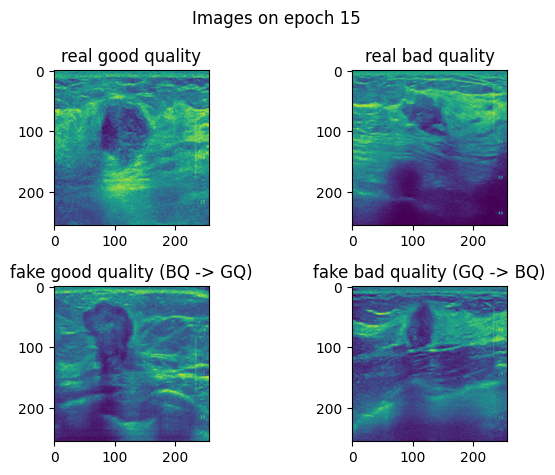

average PSNR for epoch 15 is 14.765708923339844


  0%|          | 0/50 [00:00<?, ?it/s]

average PSNR for epoch 16 is 14.170967102050781


  0%|          | 0/50 [00:00<?, ?it/s]

average PSNR for epoch 17 is 14.305188179016113


  0%|          | 0/50 [00:00<?, ?it/s]

average PSNR for epoch 18 is 14.312634468078613


  0%|          | 0/50 [00:00<?, ?it/s]

average PSNR for epoch 19 is 14.647988319396973


  0%|          | 0/50 [00:00<?, ?it/s]

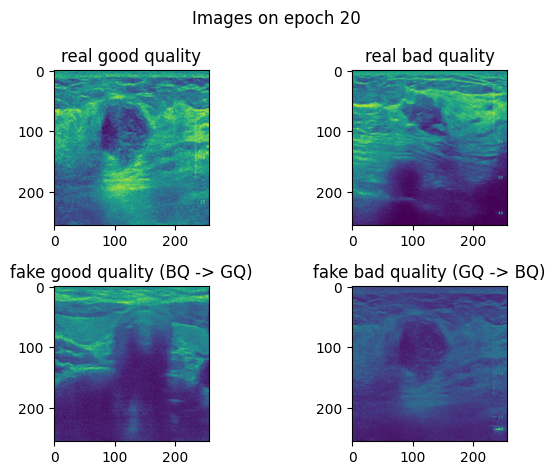

average PSNR for epoch 20 is 14.390880584716797


  0%|          | 0/50 [00:00<?, ?it/s]

average PSNR for epoch 21 is 14.611927032470703


  0%|          | 0/50 [00:00<?, ?it/s]

average PSNR for epoch 22 is 14.64238452911377


  0%|          | 0/50 [00:00<?, ?it/s]

average PSNR for epoch 23 is 14.205435752868652


  0%|          | 0/50 [00:00<?, ?it/s]

average PSNR for epoch 24 is 14.210650444030762


  0%|          | 0/50 [00:00<?, ?it/s]

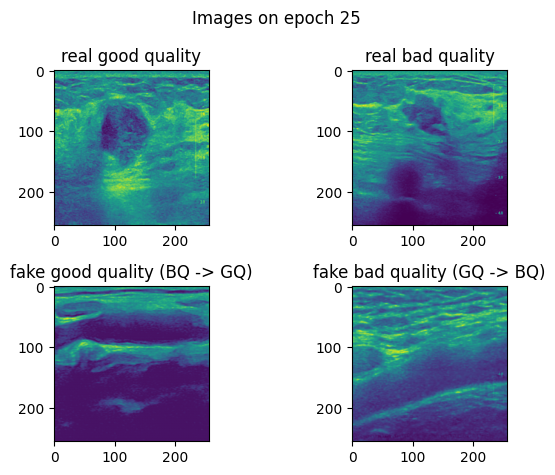

average PSNR for epoch 25 is 14.197196960449219


  0%|          | 0/50 [00:00<?, ?it/s]

average PSNR for epoch 26 is 14.18651008605957


  0%|          | 0/50 [00:00<?, ?it/s]

average PSNR for epoch 27 is 14.18507194519043


  0%|          | 0/50 [00:00<?, ?it/s]

average PSNR for epoch 28 is 14.174707412719727


  0%|          | 0/50 [00:00<?, ?it/s]

average PSNR for epoch 29 is 14.151000022888184


  0%|          | 0/50 [00:00<?, ?it/s]

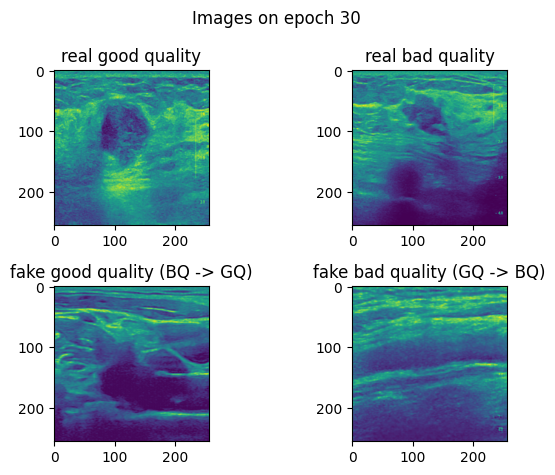

average PSNR for epoch 30 is 14.120963096618652


  0%|          | 0/50 [00:00<?, ?it/s]

average PSNR for epoch 31 is 13.78570556640625


  0%|          | 0/50 [00:00<?, ?it/s]

average PSNR for epoch 32 is 13.703513145446777


  0%|          | 0/50 [00:00<?, ?it/s]

average PSNR for epoch 33 is 13.973642349243164


  0%|          | 0/50 [00:00<?, ?it/s]

average PSNR for epoch 34 is 13.861909866333008


  0%|          | 0/50 [00:00<?, ?it/s]

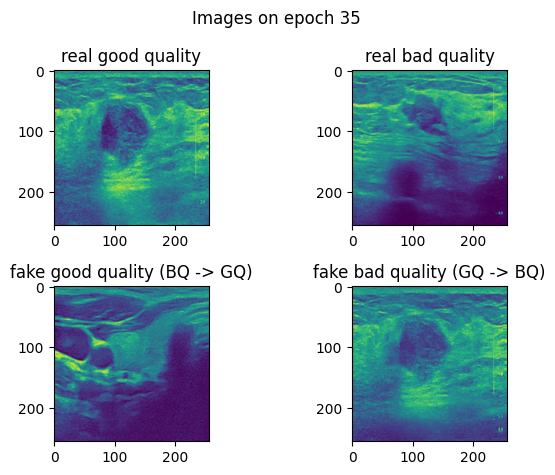

average PSNR for epoch 35 is 13.438019752502441


  0%|          | 0/50 [00:00<?, ?it/s]

average PSNR for epoch 36 is 14.023772239685059


  0%|          | 0/50 [00:00<?, ?it/s]

average PSNR for epoch 37 is 13.519920349121094


  0%|          | 0/50 [00:00<?, ?it/s]

average PSNR for epoch 38 is 13.483504295349121


  0%|          | 0/50 [00:00<?, ?it/s]

average PSNR for epoch 39 is 13.857592582702637


  0%|          | 0/50 [00:00<?, ?it/s]

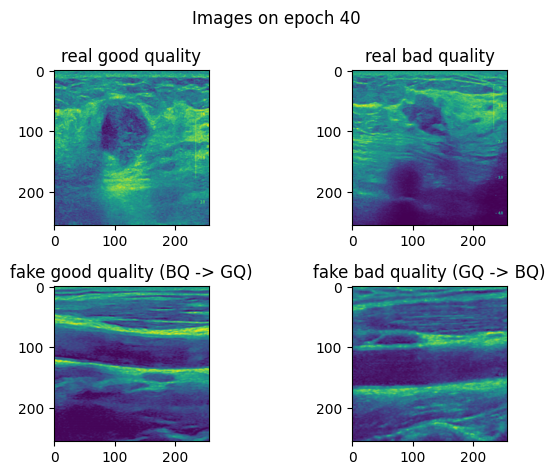

average PSNR for epoch 40 is 14.004294395446777


  0%|          | 0/50 [00:00<?, ?it/s]

average PSNR for epoch 41 is 13.979460716247559


  0%|          | 0/50 [00:00<?, ?it/s]

average PSNR for epoch 42 is 13.991233825683594


  0%|          | 0/50 [00:00<?, ?it/s]

average PSNR for epoch 43 is 14.024530410766602


  0%|          | 0/50 [00:00<?, ?it/s]

average PSNR for epoch 44 is 13.999814987182617


  0%|          | 0/50 [00:00<?, ?it/s]

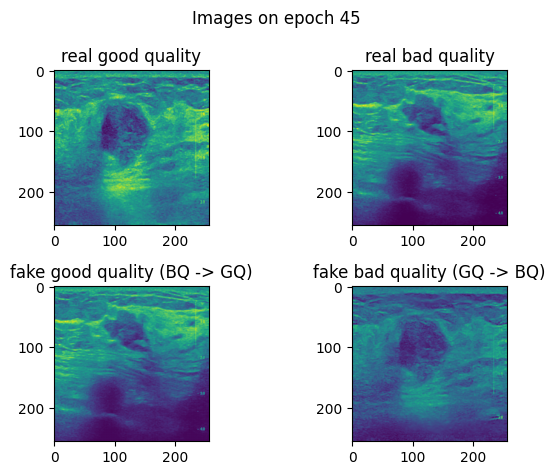

average PSNR for epoch 45 is 14.005672454833984


  0%|          | 0/50 [00:00<?, ?it/s]

average PSNR for epoch 46 is 14.024299621582031


  0%|          | 0/50 [00:00<?, ?it/s]

average PSNR for epoch 47 is 14.006635665893555


  0%|          | 0/50 [00:00<?, ?it/s]

average PSNR for epoch 48 is 14.026342391967773


  0%|          | 0/50 [00:00<?, ?it/s]

average PSNR for epoch 49 is 14.140191078186035


  0%|          | 0/50 [00:00<?, ?it/s]

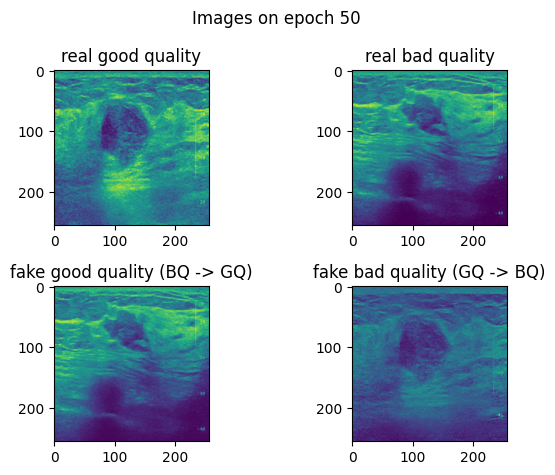

average PSNR for epoch 50 is 14.183935165405273


  0%|          | 0/50 [00:00<?, ?it/s]

average PSNR for epoch 51 is 14.338653564453125


  0%|          | 0/50 [00:00<?, ?it/s]

average PSNR for epoch 52 is 14.582653999328613


  0%|          | 0/50 [00:00<?, ?it/s]

average PSNR for epoch 53 is 14.131518363952637


  0%|          | 0/50 [00:00<?, ?it/s]

average PSNR for epoch 54 is 14.125574111938477


  0%|          | 0/50 [00:00<?, ?it/s]

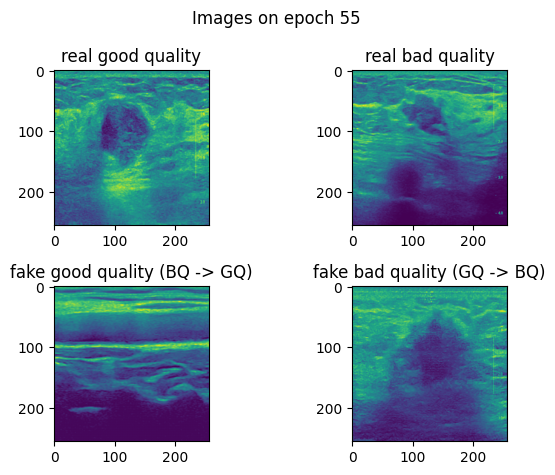

average PSNR for epoch 55 is 13.849990844726562


  0%|          | 0/50 [00:00<?, ?it/s]

average PSNR for epoch 56 is 14.013948440551758


  0%|          | 0/50 [00:00<?, ?it/s]

average PSNR for epoch 57 is 14.079257011413574


  0%|          | 0/50 [00:00<?, ?it/s]

average PSNR for epoch 58 is 14.415504455566406


  0%|          | 0/50 [00:00<?, ?it/s]

average PSNR for epoch 59 is 14.257210731506348


  0%|          | 0/50 [00:00<?, ?it/s]

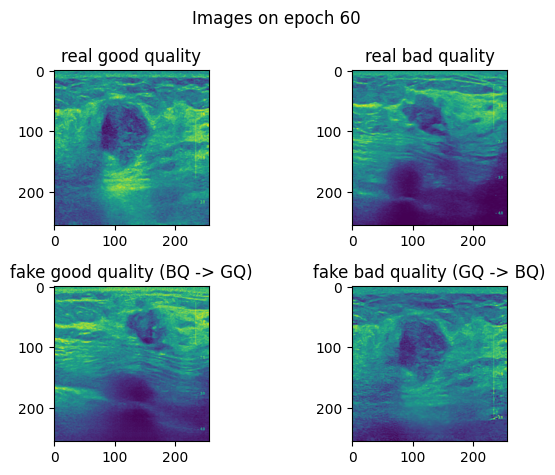

average PSNR for epoch 60 is 14.262670516967773


  0%|          | 0/50 [00:00<?, ?it/s]

average PSNR for epoch 61 is 14.128265380859375


  0%|          | 0/50 [00:00<?, ?it/s]

average PSNR for epoch 62 is 14.380999565124512


  0%|          | 0/50 [00:00<?, ?it/s]

average PSNR for epoch 63 is 14.185859680175781


  0%|          | 0/50 [00:00<?, ?it/s]

average PSNR for epoch 64 is 14.166319847106934


  0%|          | 0/50 [00:00<?, ?it/s]

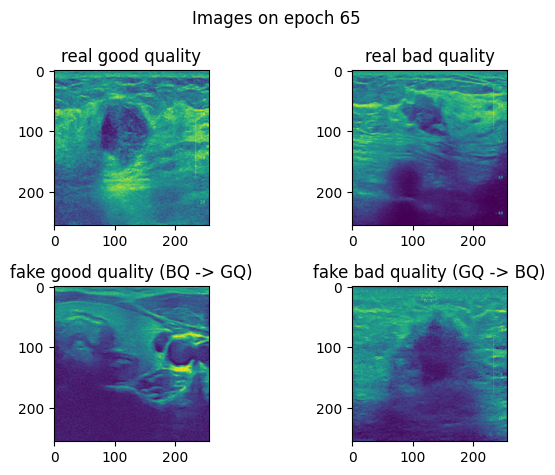

average PSNR for epoch 65 is 14.158226013183594


  0%|          | 0/50 [00:00<?, ?it/s]

average PSNR for epoch 66 is 14.153006553649902


  0%|          | 0/50 [00:00<?, ?it/s]

average PSNR for epoch 67 is 14.157051086425781


  0%|          | 0/50 [00:00<?, ?it/s]

average PSNR for epoch 68 is 14.153291702270508


  0%|          | 0/50 [00:00<?, ?it/s]

average PSNR for epoch 69 is 14.147926330566406


  0%|          | 0/50 [00:00<?, ?it/s]

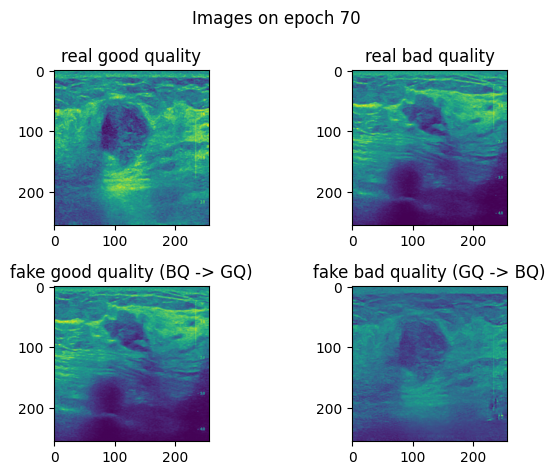

average PSNR for epoch 70 is 14.147961616516113


  0%|          | 0/50 [00:00<?, ?it/s]

average PSNR for epoch 71 is 14.14081859588623


  0%|          | 0/50 [00:00<?, ?it/s]

average PSNR for epoch 72 is 14.137718200683594


  0%|          | 0/50 [00:00<?, ?it/s]

average PSNR for epoch 73 is 14.137426376342773


  0%|          | 0/50 [00:00<?, ?it/s]

average PSNR for epoch 74 is 14.13624095916748


  0%|          | 0/50 [00:00<?, ?it/s]

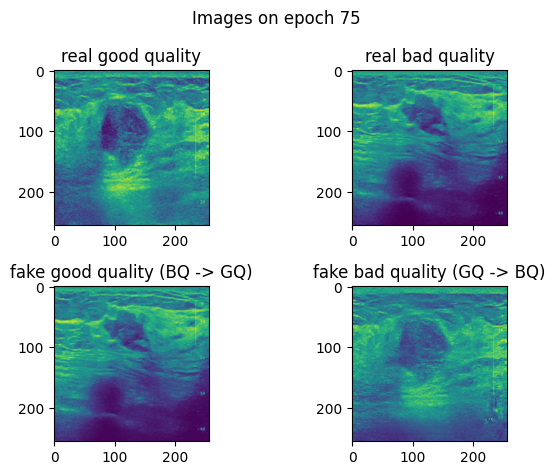

average PSNR for epoch 75 is 14.134742736816406


  0%|          | 0/50 [00:00<?, ?it/s]

average PSNR for epoch 76 is 14.132440567016602


  0%|          | 0/50 [00:00<?, ?it/s]

average PSNR for epoch 77 is 14.131185531616211


  0%|          | 0/50 [00:00<?, ?it/s]

average PSNR for epoch 78 is 14.12937068939209


  0%|          | 0/50 [00:00<?, ?it/s]

average PSNR for epoch 79 is 14.127967834472656


  0%|          | 0/50 [00:00<?, ?it/s]

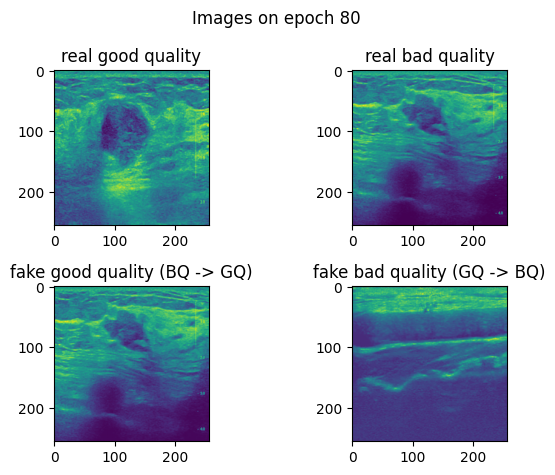

average PSNR for epoch 80 is 14.126670837402344


  0%|          | 0/50 [00:00<?, ?it/s]

average PSNR for epoch 81 is 14.124134063720703


  0%|          | 0/50 [00:00<?, ?it/s]

average PSNR for epoch 82 is 14.12414836883545


  0%|          | 0/50 [00:00<?, ?it/s]

average PSNR for epoch 83 is 14.123430252075195


  0%|          | 0/50 [00:00<?, ?it/s]

average PSNR for epoch 84 is 14.121191024780273


  0%|          | 0/50 [00:00<?, ?it/s]

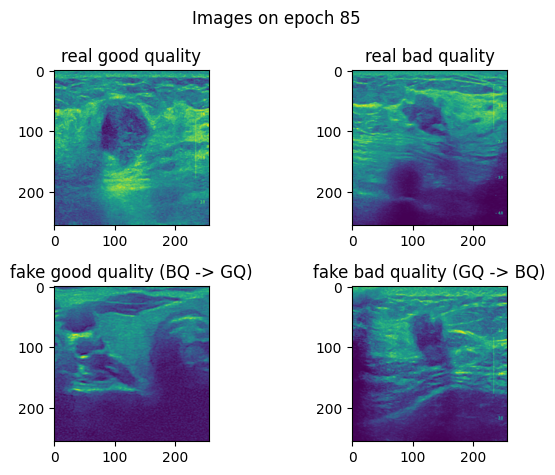

average PSNR for epoch 85 is 14.121192932128906


  0%|          | 0/50 [00:00<?, ?it/s]

average PSNR for epoch 86 is 14.121976852416992


  0%|          | 0/50 [00:00<?, ?it/s]

average PSNR for epoch 87 is 14.122068405151367


  0%|          | 0/50 [00:00<?, ?it/s]

average PSNR for epoch 88 is 14.121014595031738


  0%|          | 0/50 [00:00<?, ?it/s]

average PSNR for epoch 89 is 14.121336936950684


  0%|          | 0/50 [00:00<?, ?it/s]

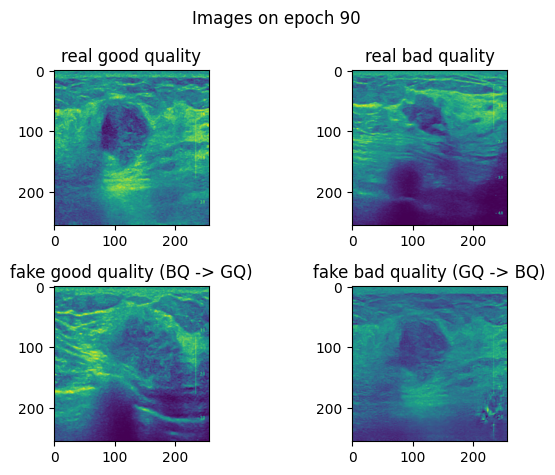

average PSNR for epoch 90 is 14.12077522277832


  0%|          | 0/50 [00:00<?, ?it/s]

average PSNR for epoch 91 is 14.119354248046875


  0%|          | 0/50 [00:00<?, ?it/s]

average PSNR for epoch 92 is 14.118644714355469


  0%|          | 0/50 [00:00<?, ?it/s]

average PSNR for epoch 93 is 14.118148803710938


  0%|          | 0/50 [00:00<?, ?it/s]

average PSNR for epoch 94 is 14.117531776428223


  0%|          | 0/50 [00:00<?, ?it/s]

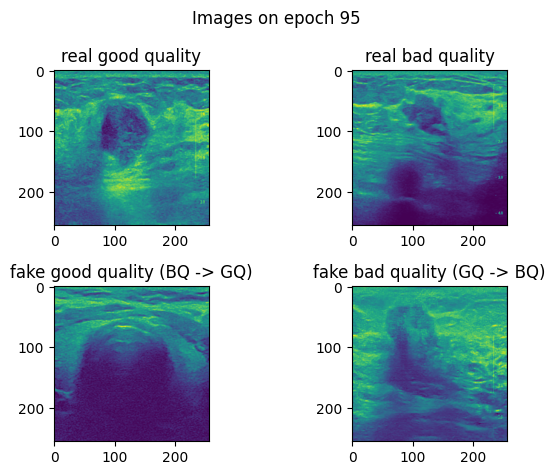

average PSNR for epoch 95 is 14.117305755615234


  0%|          | 0/50 [00:00<?, ?it/s]

average PSNR for epoch 96 is 14.116833686828613


  0%|          | 0/50 [00:00<?, ?it/s]

average PSNR for epoch 97 is 14.116667747497559


  0%|          | 0/50 [00:00<?, ?it/s]

average PSNR for epoch 98 is 14.116656303405762


  0%|          | 0/50 [00:00<?, ?it/s]

average PSNR for epoch 99 is 14.11655330657959


In [ ]:
history_us, D_A_us, D_B_us, G_A2B_us, G_B2A_us = train_model(D_A_us, D_B_us, G_A2B_us, G_B2A_us, us_trainLoader, us_validLoader, batch_size, epochs, result_dir='./us_final_result/', history=history_us, lambda_identity=100)

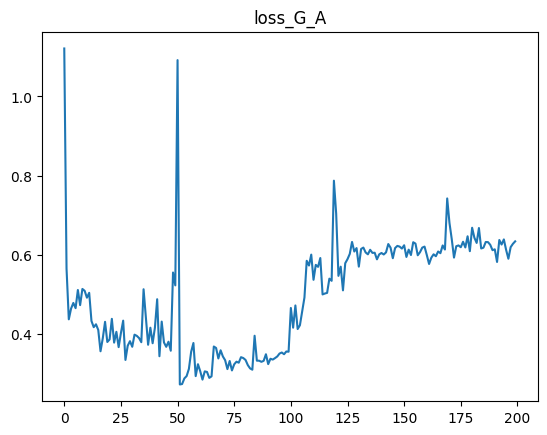

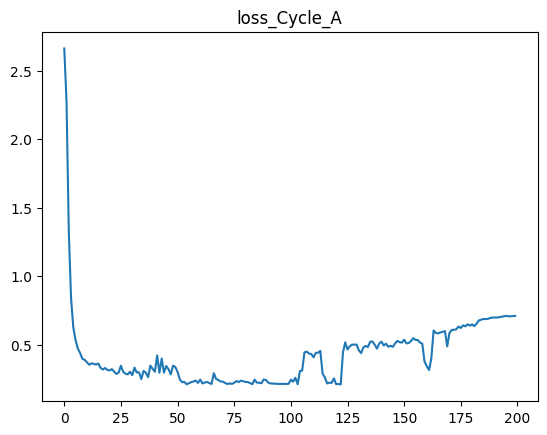

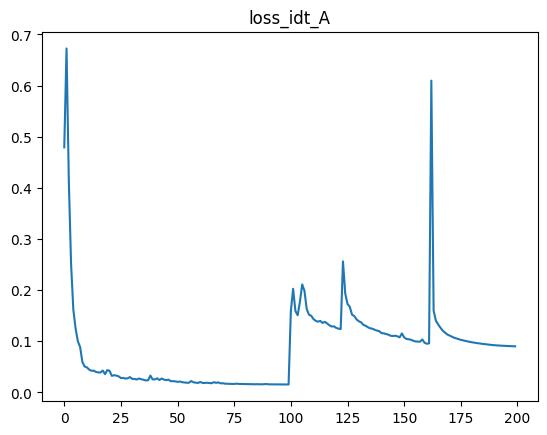

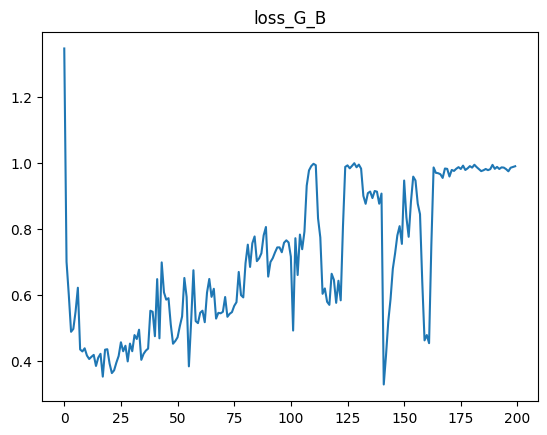

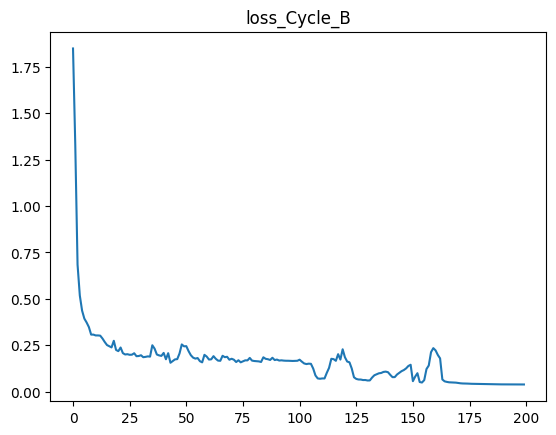

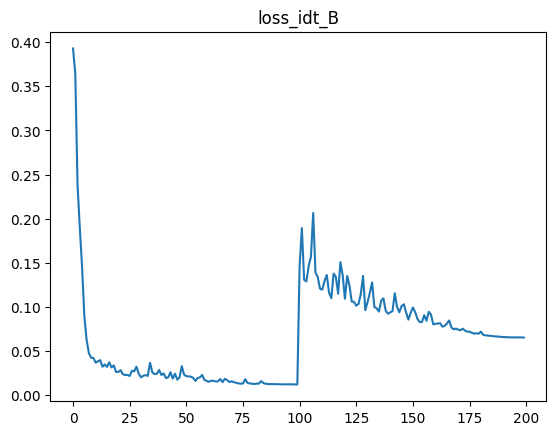

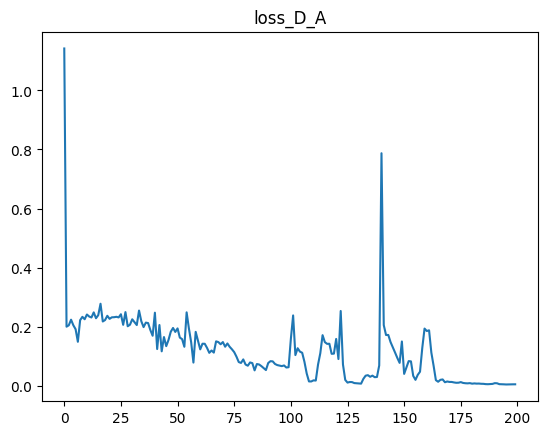

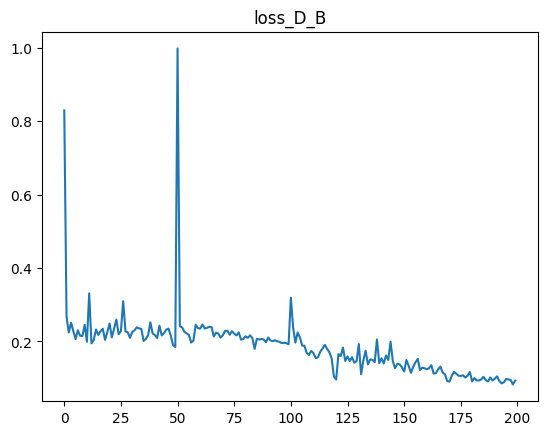

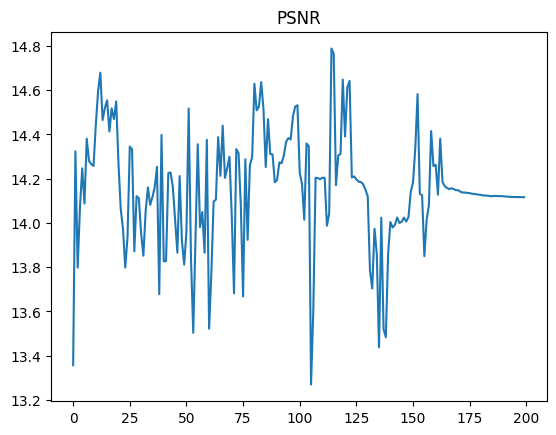

In [ ]:
for key in history_us.keys():
    plt.title(key)
    plt.plot([i for i in range(epochs*2)], history_us[key])
    plt.show()


  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

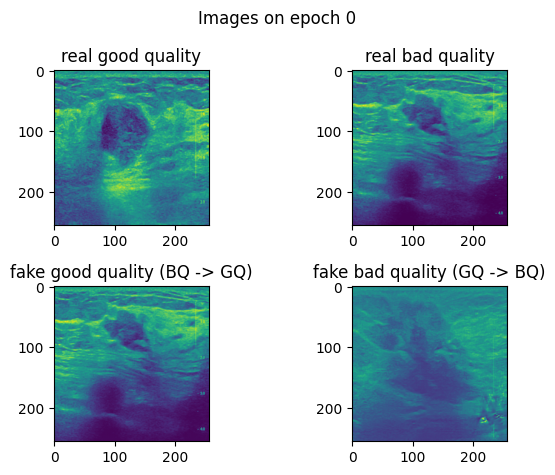

average PSNR for epoch 0 is 14.126486778259277


  0%|          | 0/50 [00:00<?, ?it/s]

average PSNR for epoch 1 is 14.13564395904541


  0%|          | 0/50 [00:00<?, ?it/s]

average PSNR for epoch 2 is 14.131317138671875


  0%|          | 0/50 [00:00<?, ?it/s]

average PSNR for epoch 3 is 14.138777732849121


  0%|          | 0/50 [00:00<?, ?it/s]

average PSNR for epoch 4 is 14.269728660583496


  0%|          | 0/50 [00:00<?, ?it/s]

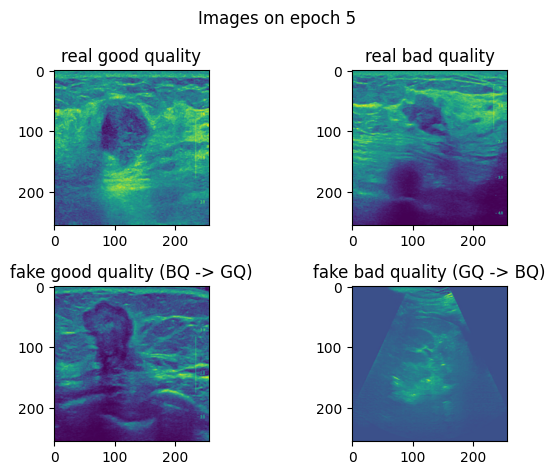

average PSNR for epoch 5 is 14.085899353027344


  0%|          | 0/50 [00:00<?, ?it/s]

average PSNR for epoch 6 is 14.167065620422363


  0%|          | 0/50 [00:00<?, ?it/s]

average PSNR for epoch 7 is 14.136663436889648


  0%|          | 0/50 [00:00<?, ?it/s]

average PSNR for epoch 8 is 14.131117820739746


  0%|          | 0/50 [00:00<?, ?it/s]

average PSNR for epoch 9 is 14.124787330627441


  0%|          | 0/50 [00:00<?, ?it/s]

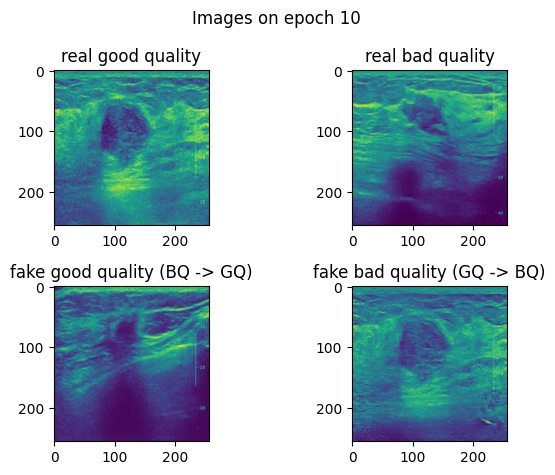

average PSNR for epoch 10 is 14.446739196777344


  0%|          | 0/50 [00:00<?, ?it/s]

average PSNR for epoch 11 is 14.427241325378418


  0%|          | 0/50 [00:00<?, ?it/s]

average PSNR for epoch 12 is 14.180828094482422


  0%|          | 0/50 [00:00<?, ?it/s]

average PSNR for epoch 13 is 14.155316352844238


  0%|          | 0/50 [00:00<?, ?it/s]

average PSNR for epoch 14 is 14.155258178710938


  0%|          | 0/50 [00:00<?, ?it/s]

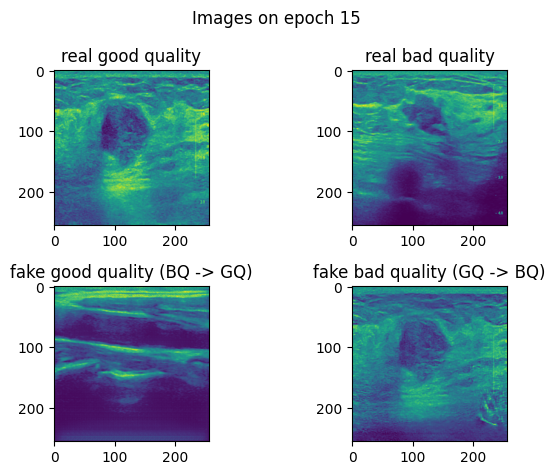

average PSNR for epoch 15 is 14.504524230957031


  0%|          | 0/50 [00:00<?, ?it/s]

average PSNR for epoch 16 is 14.465571403503418


  0%|          | 0/50 [00:00<?, ?it/s]

average PSNR for epoch 17 is 14.187519073486328


  0%|          | 0/50 [00:00<?, ?it/s]

average PSNR for epoch 18 is 14.165112495422363


  0%|          | 0/50 [00:00<?, ?it/s]

average PSNR for epoch 19 is 14.115363121032715


  0%|          | 0/50 [00:00<?, ?it/s]

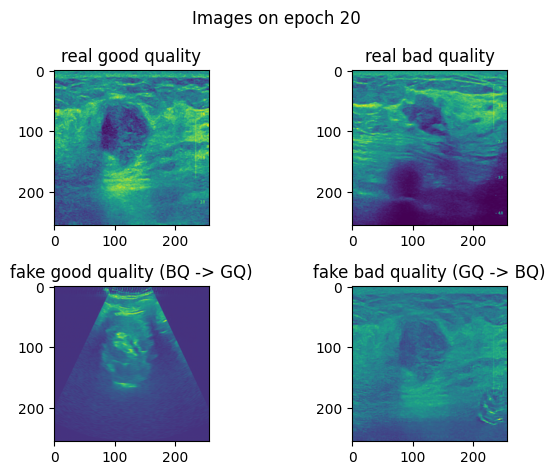

average PSNR for epoch 20 is 13.918404579162598


  0%|          | 0/50 [00:00<?, ?it/s]

average PSNR for epoch 21 is 14.642972946166992


  0%|          | 0/50 [00:00<?, ?it/s]

average PSNR for epoch 22 is 13.497445106506348


  0%|          | 0/50 [00:00<?, ?it/s]

average PSNR for epoch 23 is 14.24215316772461


  0%|          | 0/50 [00:00<?, ?it/s]

average PSNR for epoch 24 is 13.76605224609375


  0%|          | 0/50 [00:00<?, ?it/s]

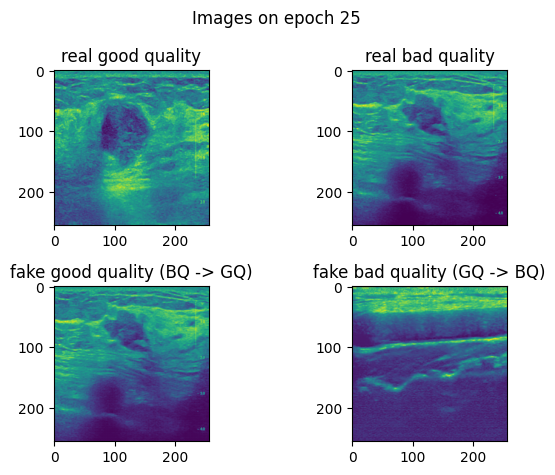

average PSNR for epoch 25 is 14.015403747558594


  0%|          | 0/50 [00:00<?, ?it/s]

average PSNR for epoch 26 is 13.374377250671387


  0%|          | 0/50 [00:00<?, ?it/s]

average PSNR for epoch 27 is 13.762165069580078


  0%|          | 0/50 [00:00<?, ?it/s]

average PSNR for epoch 28 is 13.834105491638184


  0%|          | 0/50 [00:00<?, ?it/s]

average PSNR for epoch 29 is 13.70787239074707


  0%|          | 0/50 [00:00<?, ?it/s]

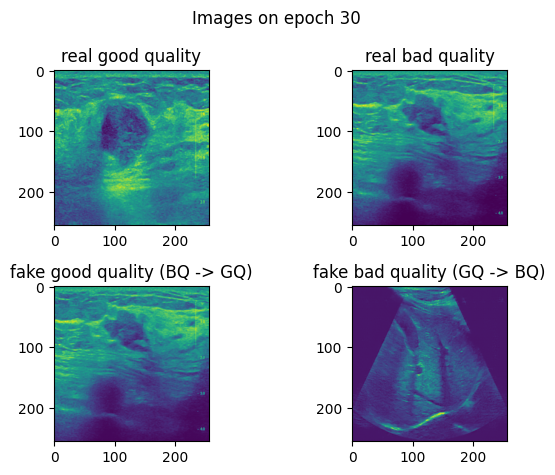

average PSNR for epoch 30 is 13.781243324279785


  0%|          | 0/50 [00:00<?, ?it/s]

average PSNR for epoch 31 is 14.252901077270508


  0%|          | 0/50 [00:00<?, ?it/s]

average PSNR for epoch 32 is 13.75329303741455


  0%|          | 0/50 [00:00<?, ?it/s]

average PSNR for epoch 33 is 14.253936767578125


  0%|          | 0/50 [00:00<?, ?it/s]

average PSNR for epoch 34 is 14.109293937683105


  0%|          | 0/50 [00:00<?, ?it/s]

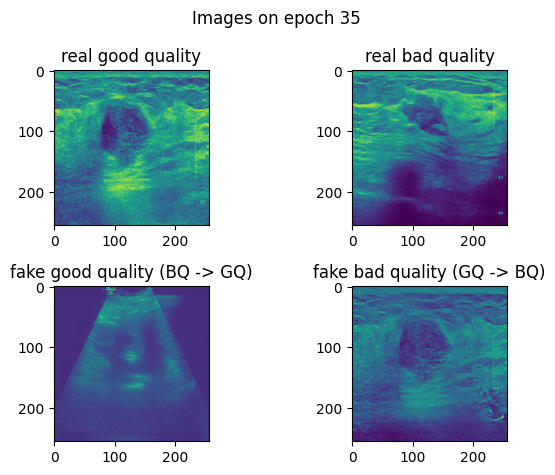

average PSNR for epoch 35 is 14.269081115722656


  0%|          | 0/50 [00:00<?, ?it/s]

average PSNR for epoch 36 is 14.363105773925781


  0%|          | 0/50 [00:00<?, ?it/s]

average PSNR for epoch 37 is 14.372426986694336


  0%|          | 0/50 [00:00<?, ?it/s]

average PSNR for epoch 38 is 14.299530982971191


  0%|          | 0/50 [00:00<?, ?it/s]

average PSNR for epoch 39 is 14.237946510314941


  0%|          | 0/50 [00:00<?, ?it/s]

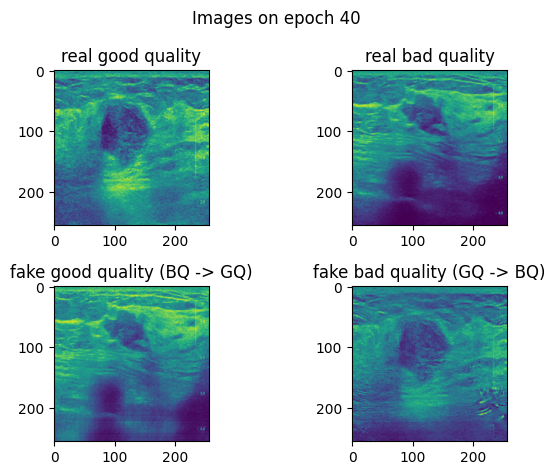

average PSNR for epoch 40 is 14.438481330871582


  0%|          | 0/50 [00:00<?, ?it/s]

average PSNR for epoch 41 is 14.324197769165039


  0%|          | 0/50 [00:00<?, ?it/s]

average PSNR for epoch 42 is 14.48246955871582


  0%|          | 0/50 [00:00<?, ?it/s]

average PSNR for epoch 43 is 14.475712776184082


  0%|          | 0/50 [00:00<?, ?it/s]

average PSNR for epoch 44 is 14.383462905883789


  0%|          | 0/50 [00:00<?, ?it/s]

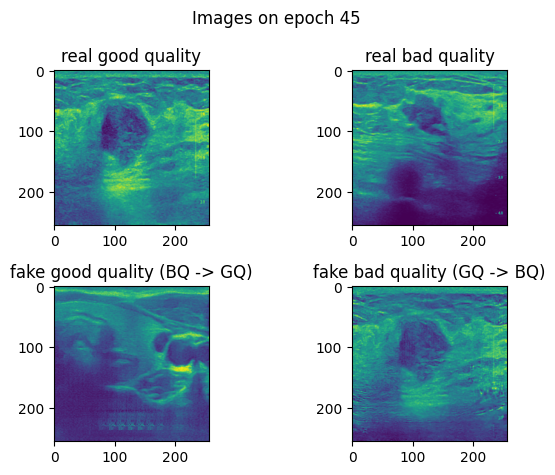

average PSNR for epoch 45 is 14.411246299743652


  0%|          | 0/50 [00:00<?, ?it/s]

average PSNR for epoch 46 is 14.454110145568848


  0%|          | 0/50 [00:00<?, ?it/s]

average PSNR for epoch 47 is 14.408039093017578


  0%|          | 0/50 [00:00<?, ?it/s]

average PSNR for epoch 48 is 14.497156143188477


  0%|          | 0/50 [00:00<?, ?it/s]

average PSNR for epoch 49 is 14.502449989318848


In [ ]:
history_us, D_A_us, D_B_us, G_A2B_us, G_B2A_us = train_model(D_A_us, D_B_us, G_A2B_us, G_B2A_us, us_trainLoader, us_validLoader, batch_size, epochs=50, result_dir='./us_final_result/', history=history_us, lambda_identity=100)

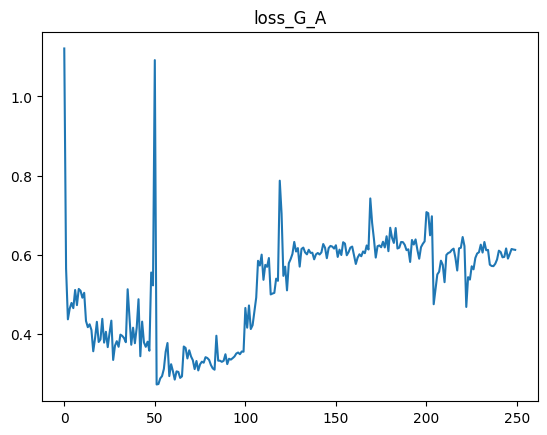

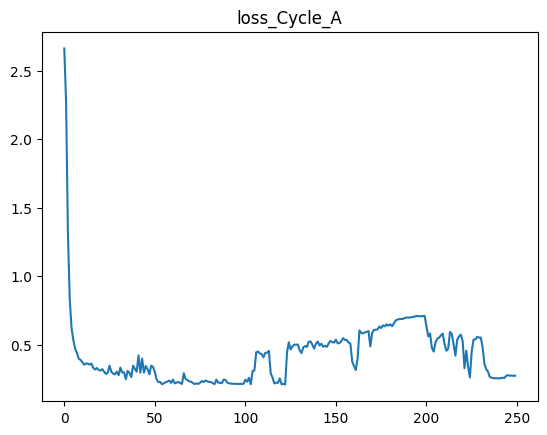

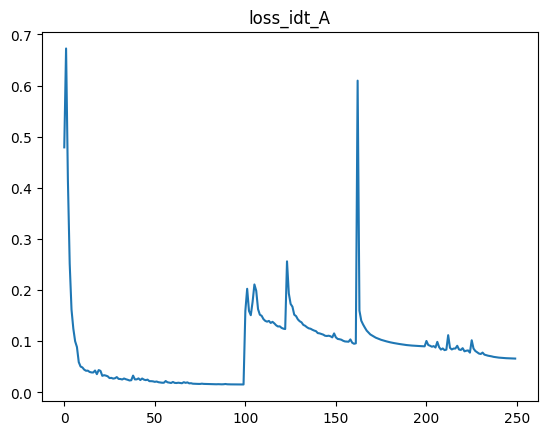

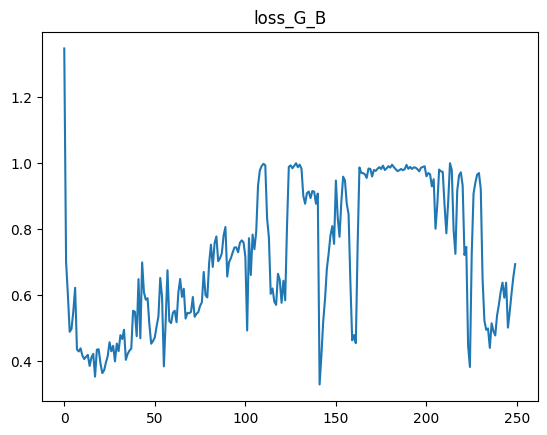

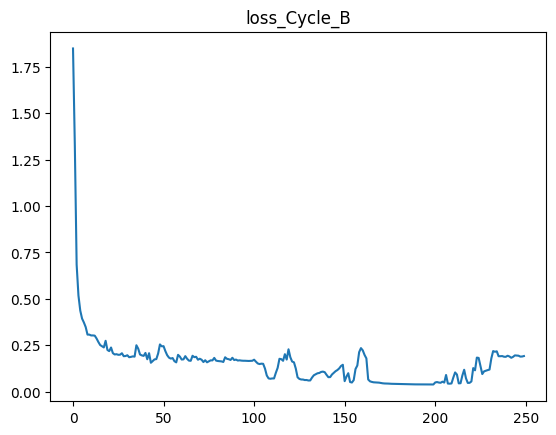

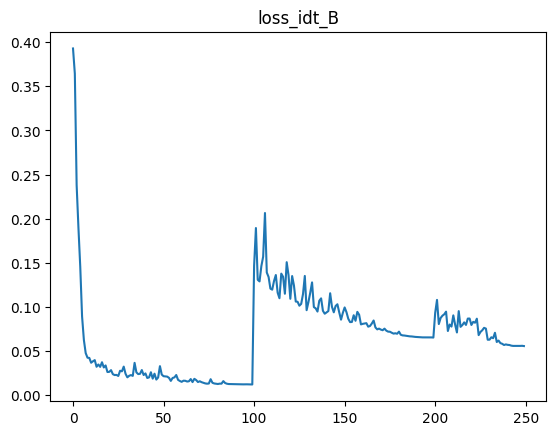

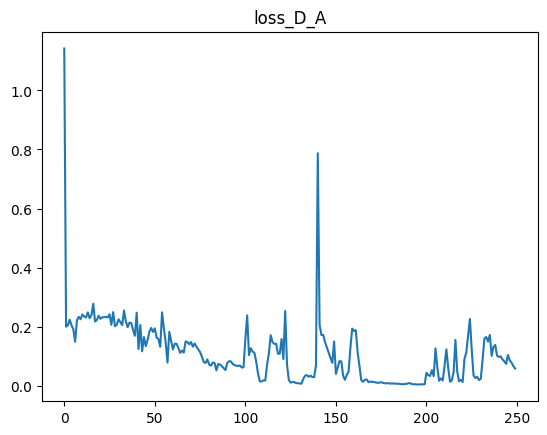

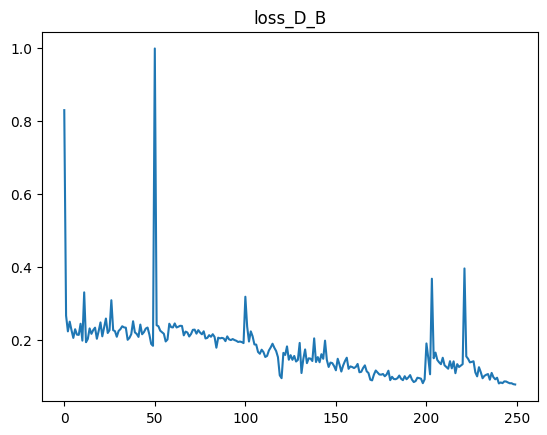

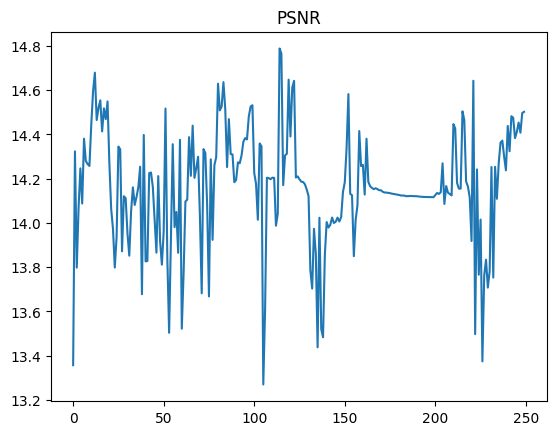

In [ ]:
for key in history_us.keys():
    plt.title(key)
    plt.plot([i for i in range(250)], history_us[key])
    plt.show()

Из-за большой разницы изображений (и что в каждой паре эта разница разная), обучить модель оказалось очень нетривиально и применение этой архитектуры является скорее экспериментом (очевидно, неудачным).

## Unified dataset

Объединим оба датасета в рамках эксперимента

In [ ]:
class UnifiedDataset(Dataset):
    def __init__(self, dataset1, dataset2):
        self.dataset1 = dataset1
        self.dataset2 = dataset2
        self.total_len = len(dataset1) + len(dataset2)

    def __len__(self):
        return self.total_len - 1

    def __getitem__(self, idx):
        if idx < len(self.dataset1):
            return self.dataset1[idx]
        else:
            return self.dataset2[idx - len(self.dataset1)]

In [ ]:
unifTransforms=transforms.Compose([
    transforms.RandomCrop((256,256)),
])

ct_trainDataset_for_unif=makeDataset('/content/ct_data/data', 'ct', unifTransforms)
ct_validDataset_for_unif=makeDataset('/content/ct_data/data', 'ct', transform=unifTransforms, mode='test')

In [ ]:
us_trainDataset_for_unif=makeDataset_us('/content/us_data', 'us', unifTransforms)
us_validDataset_for_unif=makeDataset_us('/content/us_data', 'us', transform=unifTransforms, mode='test')

In [ ]:
unif_train = UnifiedDataset(us_trainDataset_for_unif, ct_trainDataset_for_unif)
unif_trainloader =DataLoader(unif_train,batch_size=batch_size,shuffle=True)

unif_test = UnifiedDataset(ct_validDataset_for_unif, us_validDataset_for_unif)
unif_validloader =DataLoader(unif_test,batch_size=batch_size,shuffle=True)

In [ ]:
norm_type='batch'
epochs=50
lambda_identity=0.5
lambda_A=10.0
lambda_B=10.0
lr=0.0002
ngf=64
ndf=64
use_droplayer=False
batch_size=16
norm_layer = functools.partial(nn.InstanceNorm2d, affine=False, track_running_stats=False)
DEVICE='cuda' if torch.cuda.is_available() else 'cpu'

In [ ]:
G_A2B_un=UNetGenerator(in_c=1,out_c=1,ngf=ngf,norm_layer=norm_layer,use_drop=use_droplayer)
G_B2A_un=UNetGenerator(in_c=1,out_c=1,ngf=ngf,norm_layer=norm_layer,use_drop=use_droplayer)

D_A_un=Discriminator(in_c=1,ndf=ndf,n_layers=3,norm_layer=norm_layer)
D_B_un=Discriminator(in_c=1,ndf=ndf,n_layers=3,norm_layer=norm_layer)

In [ ]:
G_A2B_un.to(DEVICE)
G_B2A_un.to(DEVICE)
D_A_un.to(DEVICE)
D_B_un.to(DEVICE)

G_A2B_un.apply(init_weight)
G_B2A_un.apply(init_weight)
D_A_un.apply(init_weight)
D_B_un.apply(init_weight)

if torch.cuda.device_count() > 1:
    print('training with {} GPUs'.format(torch.cuda.device_count()))
    G_A2B_un=torch.nn.DataParallel(G_A2B_un)
    G_B2A_un=torch.nn.DataParallel(G_B2A_un)
    D_A_un=torch.nn.DataParallel(D_A_un)
    D_B_un=torch.nn.DataParallel(D_B_un)

In [ ]:
lossGAN=nn.MSELoss()
lossCycle=nn.L1Loss()
lossIdentity=nn.L1Loss()

In [ ]:

psnr=PeakSignalNoiseRatio(data_range=1,dim=[-1,-2,-3])

trainTransforms=transforms.Compose([
    transforms.RandomCrop((256,256)),
])

history_un={'loss_G_A':[],'loss_Cycle_A':[],'loss_idt_A':[],
         'loss_G_B':[],'loss_Cycle_B':[],'loss_idt_B':[],'loss_D_A':[],'loss_D_B':[],'PSNR':[]}

if not os.path.exists('./un_final_result'):
    os.makedirs('./un_final_result')
if not os.path.exists('./un_final_result/GAN_FD_to_QD'):
    os.makedirs('./un_final_result/GAN_FD_to_QD')
if not os.path.exists('./un_final_result/GAN_QD_to_FD'):
    os.makedirs('./un_final_result/GAN_QD_to_FD')
if not os.path.exists('./un_final_result/Discriminator_A'):
    os.makedirs('./un_final_result/Discriminator_A')
if not os.path.exists('./un_final_result/Discriminator_B'):
    os.makedirs('./un_final_result/Discriminator_B')


/usr/local/lib/python3.11/dist-packages/torchmetrics/utilities/prints.py:62: FutureWarning: Importing `PeakSignalNoiseRatio` from `torchmetrics` was deprecated and will be removed in 2.0. Import `PeakSignalNoiseRatio` from `torchmetrics.image` instead.
  _future_warning(


  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/289 [00:00<?, ?it/s]

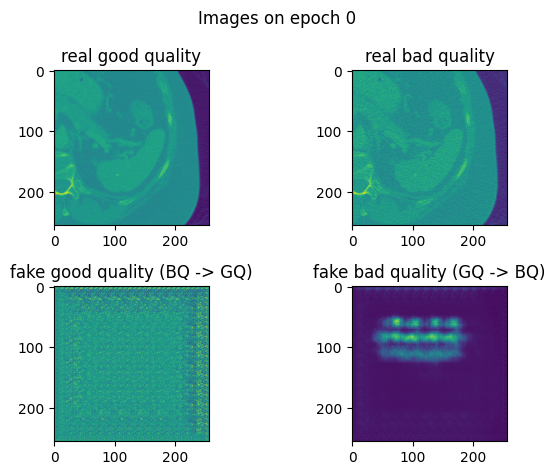

average PSNR for epoch 0 is 10.456657409667969


  0%|          | 0/289 [00:00<?, ?it/s]

average PSNR for epoch 1 is 11.906098365783691


  0%|          | 0/289 [00:00<?, ?it/s]

average PSNR for epoch 2 is 10.961504936218262


  0%|          | 0/289 [00:00<?, ?it/s]

average PSNR for epoch 3 is 12.842408180236816


  0%|          | 0/289 [00:00<?, ?it/s]

average PSNR for epoch 4 is 17.45612335205078


  0%|          | 0/289 [00:00<?, ?it/s]

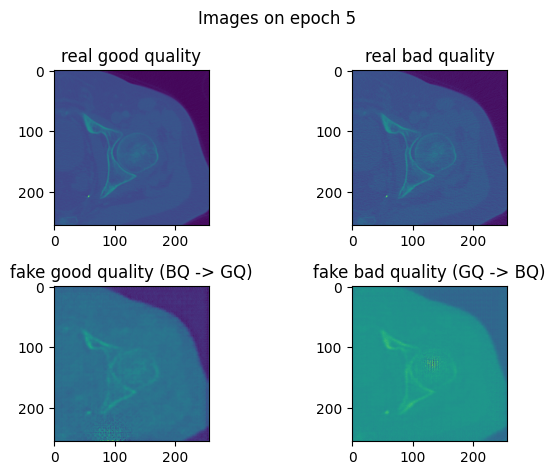

average PSNR for epoch 5 is 18.116363525390625


  0%|          | 0/289 [00:00<?, ?it/s]

average PSNR for epoch 6 is 18.487211227416992


  0%|          | 0/289 [00:00<?, ?it/s]

average PSNR for epoch 7 is 20.409461975097656


  0%|          | 0/289 [00:00<?, ?it/s]

average PSNR for epoch 8 is 15.267251968383789


  0%|          | 0/289 [00:00<?, ?it/s]

average PSNR for epoch 9 is 16.809280395507812


  0%|          | 0/289 [00:00<?, ?it/s]

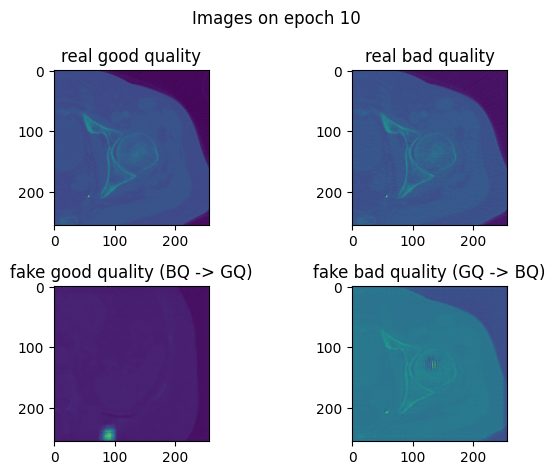

average PSNR for epoch 10 is 12.902562141418457


  0%|          | 0/289 [00:00<?, ?it/s]

average PSNR for epoch 11 is 18.674606323242188


  0%|          | 0/289 [00:00<?, ?it/s]

average PSNR for epoch 12 is 16.966157913208008


  0%|          | 0/289 [00:00<?, ?it/s]

average PSNR for epoch 13 is 13.715431213378906


  0%|          | 0/289 [00:00<?, ?it/s]

average PSNR for epoch 14 is 12.563337326049805


  0%|          | 0/289 [00:00<?, ?it/s]

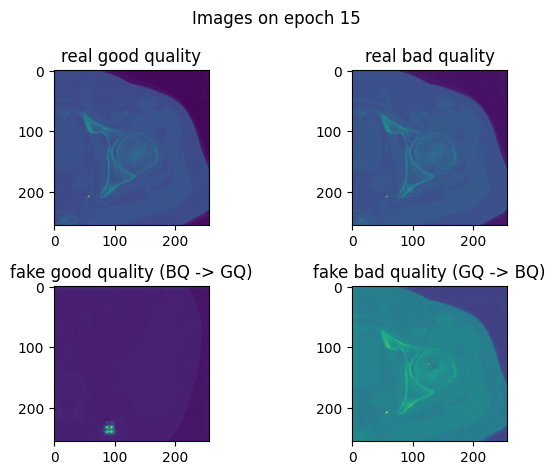

average PSNR for epoch 15 is 12.673528671264648


  0%|          | 0/289 [00:00<?, ?it/s]

average PSNR for epoch 16 is 15.045543670654297


  0%|          | 0/289 [00:00<?, ?it/s]

average PSNR for epoch 17 is 12.475172996520996


  0%|          | 0/289 [00:00<?, ?it/s]

average PSNR for epoch 18 is 15.199472427368164


  0%|          | 0/289 [00:00<?, ?it/s]

average PSNR for epoch 19 is 11.961760520935059


  0%|          | 0/289 [00:00<?, ?it/s]

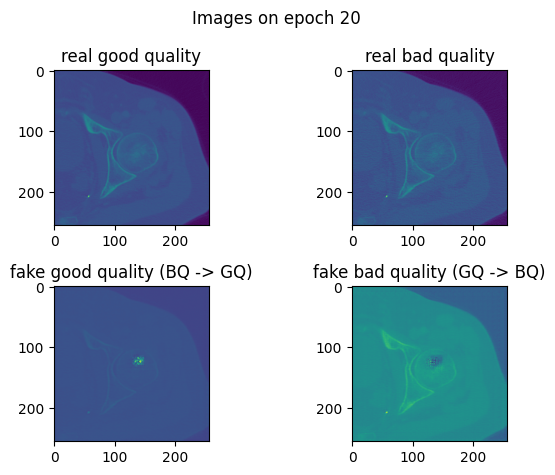

average PSNR for epoch 20 is 15.104430198669434


  0%|          | 0/289 [00:00<?, ?it/s]

average PSNR for epoch 21 is 15.583802223205566


  0%|          | 0/289 [00:00<?, ?it/s]

average PSNR for epoch 22 is 14.739228248596191


  0%|          | 0/289 [00:00<?, ?it/s]

average PSNR for epoch 23 is 14.510529518127441


  0%|          | 0/289 [00:00<?, ?it/s]

average PSNR for epoch 24 is 14.692313194274902


  0%|          | 0/289 [00:00<?, ?it/s]

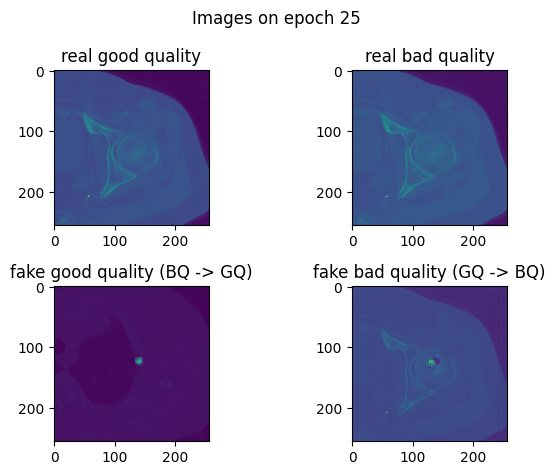

average PSNR for epoch 25 is 12.000678062438965


  0%|          | 0/289 [00:00<?, ?it/s]

average PSNR for epoch 26 is 13.650938987731934


  0%|          | 0/289 [00:00<?, ?it/s]

average PSNR for epoch 27 is 13.76693344116211


  0%|          | 0/289 [00:00<?, ?it/s]

average PSNR for epoch 28 is 12.37459945678711


  0%|          | 0/289 [00:00<?, ?it/s]

average PSNR for epoch 29 is 13.283804893493652


  0%|          | 0/289 [00:00<?, ?it/s]

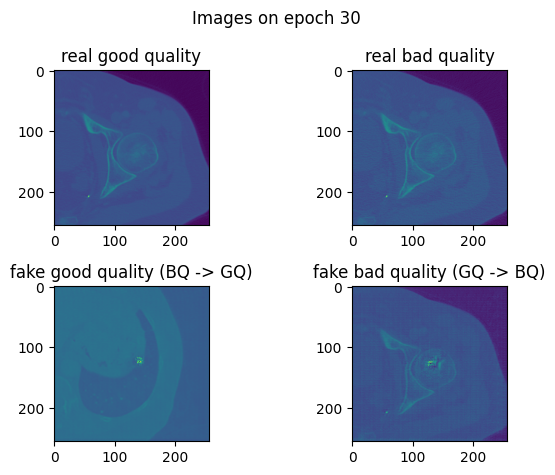

average PSNR for epoch 30 is 15.92190170288086


  0%|          | 0/289 [00:00<?, ?it/s]

average PSNR for epoch 31 is 16.15375518798828


  0%|          | 0/289 [00:00<?, ?it/s]

average PSNR for epoch 32 is 15.346137046813965


  0%|          | 0/289 [00:00<?, ?it/s]

average PSNR for epoch 33 is 13.214463233947754


  0%|          | 0/289 [00:00<?, ?it/s]

average PSNR for epoch 34 is 14.015503883361816


  0%|          | 0/289 [00:00<?, ?it/s]

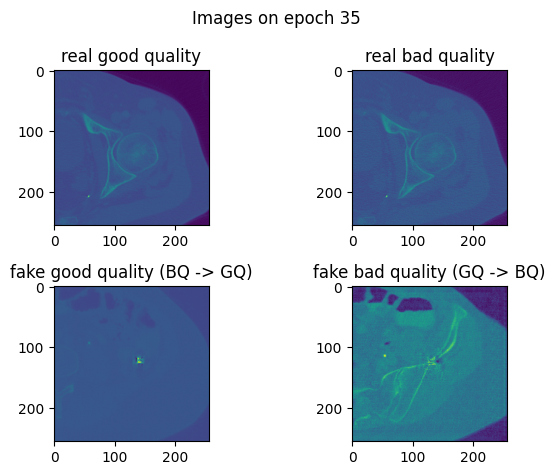

average PSNR for epoch 35 is 15.0050048828125


  0%|          | 0/289 [00:00<?, ?it/s]

average PSNR for epoch 36 is 15.518540382385254


  0%|          | 0/289 [00:00<?, ?it/s]

average PSNR for epoch 37 is 15.636689186096191


  0%|          | 0/289 [00:00<?, ?it/s]

average PSNR for epoch 38 is 16.187528610229492


  0%|          | 0/289 [00:00<?, ?it/s]

average PSNR for epoch 39 is 13.947640419006348


  0%|          | 0/289 [00:00<?, ?it/s]

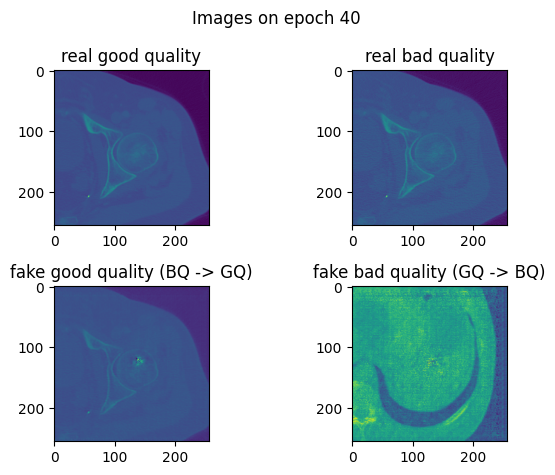

average PSNR for epoch 40 is 15.70406723022461


  0%|          | 0/289 [00:00<?, ?it/s]

average PSNR for epoch 41 is 15.733710289001465


  0%|          | 0/289 [00:00<?, ?it/s]

average PSNR for epoch 42 is 19.915708541870117


  0%|          | 0/289 [00:00<?, ?it/s]

average PSNR for epoch 43 is 20.2164306640625


  0%|          | 0/289 [00:00<?, ?it/s]

average PSNR for epoch 44 is 18.587255477905273


  0%|          | 0/289 [00:00<?, ?it/s]

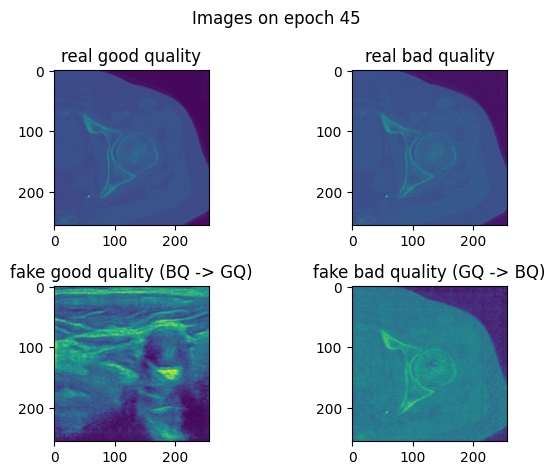

average PSNR for epoch 45 is 18.1177921295166


  0%|          | 0/289 [00:00<?, ?it/s]

average PSNR for epoch 46 is 15.463117599487305


  0%|          | 0/289 [00:00<?, ?it/s]

average PSNR for epoch 47 is 18.26390838623047


  0%|          | 0/289 [00:00<?, ?it/s]

average PSNR for epoch 48 is 18.32382583618164


  0%|          | 0/289 [00:00<?, ?it/s]

average PSNR for epoch 49 is 19.086336135864258


In [ ]:
history_un, D_A_un, D_B_un, G_A2B_un, G_B2A_un = train_model(D_A_un, D_B_un, G_A2B_un, G_B2A_un, unif_trainloader, unif_validloader, batch_size, epochs, result_dir='./un_final_result/', history=history_un)

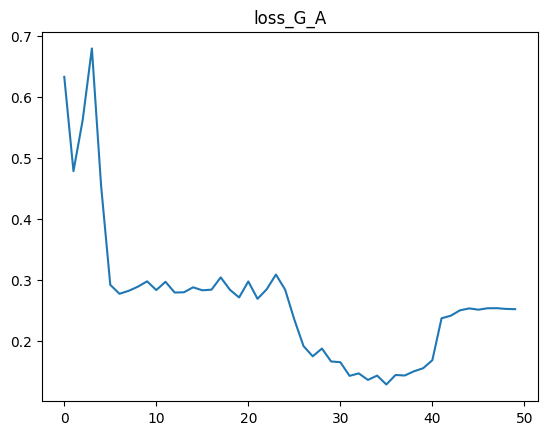

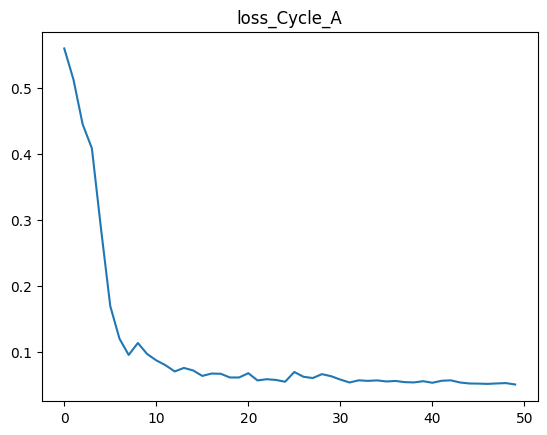

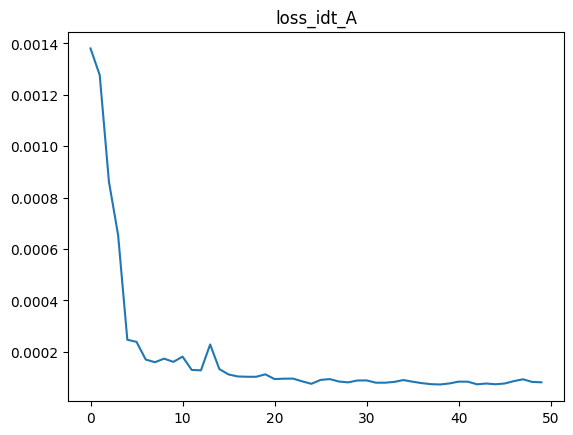

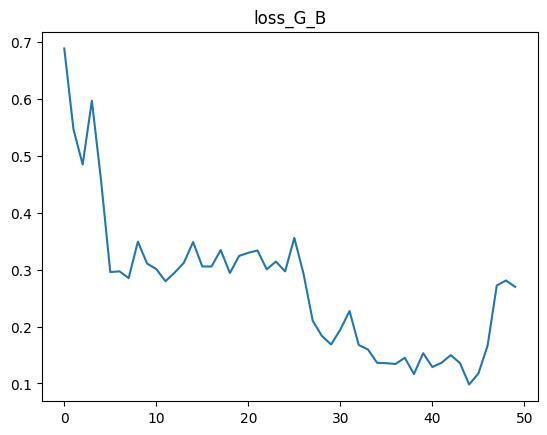

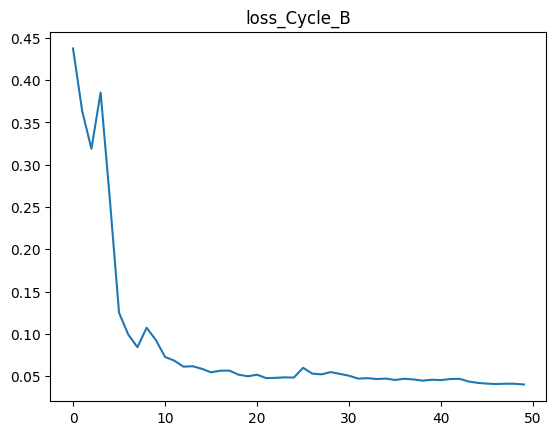

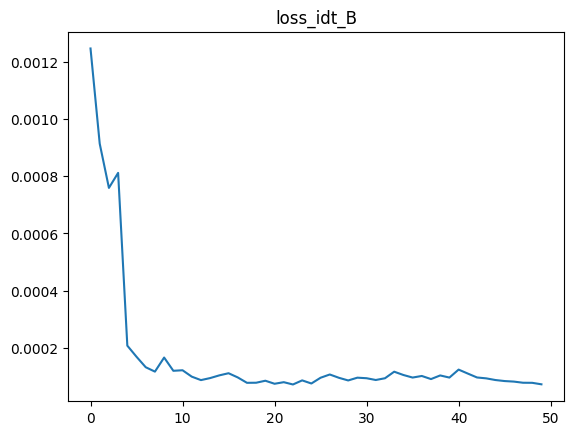

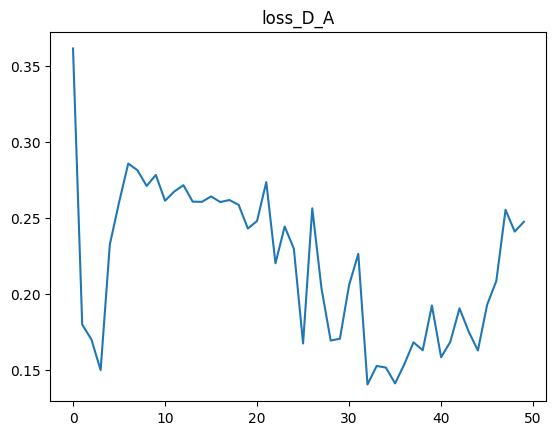

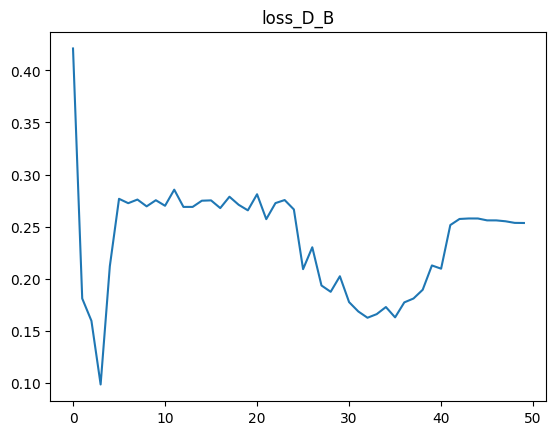

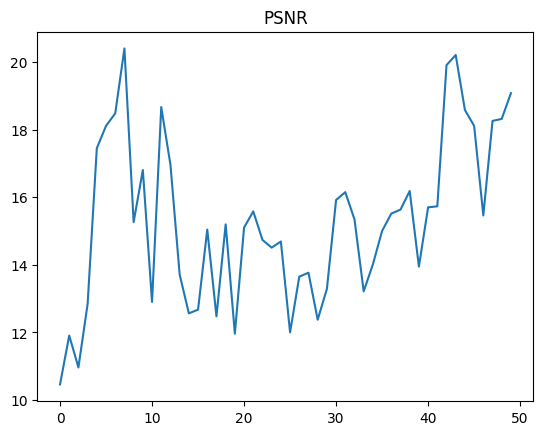

In [ ]:
for key in history_un.keys():
    plt.title(key)
    plt.plot([i for i in range(epochs)], history_un[key])
    plt.show()

Видим большую нестабильность всех метрик, обучение идет в основном за счет подгонки под превалирующий КТ датасет.

# Выводы

В ходе проекта я постаралась воспроизвести модель, полученную другими людьми. Причин неудачи может быть несколько:

*   неправильный рефакторинг: хоть я и перепроверяла, что я убираю только неиспользуемые параметры, могла быть допущена ошибка
*   магия сида
*   другое количество эпох: я использовала 100 против авторских 80, но фиксация произошла до 80 эпохи, вместе с максимумом PSNR
*   другие версии библиотек

Подробнее о результатах и проблемах я написала в инференсе и в README.md.